Imports

In [1]:
# standard modules
import copy
import os
import re
# 3rd party modules
import matplotlib.pyplot as plt
plt.style.use('tableau-colorblind10')
plt.rcParams["font.sans-serif"] = 'Arial'
import matplotlib
from matplotlib import lines
pltline2d = lines.Line2D
import seaborn as sns
import numpy as np
import pandas as pd
pd.DataFrame.columnstartswith = lambda self, x: [c for c in self.columns if c.startswith(x)]
pd.DataFrame.columnsmatch = lambda self, x: [c for c in self.columns if re.findall(x, c)]
from sklearn.linear_model import LinearRegression
from functools import reduce
from rpy2.robjects.packages import SignatureTranslatedAnonymousPackage as RPackage, importr
from rpy2.robjects import pandas2ri
# Project modules
MDS_gapfill_and_partition = RPackage(''.join(open('coimbra2023_gapfilling.R', 'r').readlines()), 'MDS_gapfill_and_partition').__dict__['do_gapfill']


cffi mode is CFFI_MODE.ANY
Unable to determine R home: [WinError 2] Le fichier spécifié est introuvable
R home found: C:\Program Files\R\R-4.1.3
Default options to initialize R: rpy2, --quiet, --no-save
R[write to console]: 
Attachement du package : 'dplyr'


Exception ignored from cffi callback <function _consolewrite_ex at 0x000002C2FF99C940>:
Traceback (most recent call last):
  File "c:\Users\phherigcoimb\Anaconda3\envs\talltower\lib\site-packages\rpy2\rinterface_lib\callbacks.py", line 133, in _consolewrite_ex
    s = conversion._cchar_to_str_with_maxlen(buf, n, _CCHAR_ENCODING)
  File "c:\Users\phherigcoimb\Anaconda3\envs\talltower\lib\site-packages\rpy2\rinterface_lib\conversion.py", line 138, in _cchar_to_str_with_maxlen
    s = ffi.string(c, maxlen).decode(encoding)
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xe9 in position 30: invalid continuation byte
Exception ignored from cffi callback <function _consolewrite_ex at 0x000002C2FF99C940>:
Traceback (most recent call

Useful functions

In [131]:
class structuredData:
    def __init__(self, **kwargs):
        for k, v in kwargs.items(): self.__dict__[k]=v
        pass

month2season = lambda month: {1:1, 2:1, 3:2, 4:2, 5:2, 6:3, 7:3, 8:3, 9:4, 10:4, 11:4, 12:1}[month]

def partitionDWCS(data):
    #lightresponse = lambda p: np.where(np.isnan(p), 1, (p-np.nanmin(p))/(np.nanmax(p)-np.nanmin(p)))
    #data["DW_GPP_withPARratio"] = np.where((np.isnan(data.PPFD)==False) * (data.PPFD<10), 0, 1) * (
    #    data["dwt_wco2-+h2o_uStar_f"] + lightresponse(data["PPFD"]) * (data["dwt_wco2--h2o_uStar_f"]))
    #data["DW_Reco_withPARratio"] = (data["DWT_NEE_uStar_f"] - data["DW_GPP_withPARratio"])
    
    data["DW_GPP"] = np.where((np.isnan(data.PPFD_IN) == False) * (data.PPFD_IN < 10), 0, 1) * (
        data["dwt_wco2-+wh2o_uStar_f"] + 0.5*data["dwt_wco2--wh2o_uStar_f"])
    data["DW_Reco"] = (data["DWT_NEE_uStar_f"] - data["DW_GPP"])
    return data

def summarisestats(X, y):
    statisticsToReturn = structuredData()
    X = np.array(X)
    y = np.array(y)
    NaN = np.isnan(X) + np.isnan(y)
    X = X[NaN==0]
    y = y[NaN==0]
    statisticsToReturn.me = np.nanmean((X-y)).round(2)
    statisticsToReturn.mae = np.nanmean(abs(X-y)).round(2)
    regression = LinearRegression(fit_intercept=False)
    regression.fit(X.reshape(-1, 1), y.reshape(-1, 1))
    statisticsToReturn.m = regression.coef_[0][0]
    b = regression.intercept_
    statisticsToReturn.b = b
    b_ = np.round(b[0], 2) if b else 0
    b_ = "+" + str(b_) if b_ >= 0 else str(b_)
    statisticsToReturn.r2 = regression.score(X.reshape(-1, 1), y.reshape(-1, 1))
    return statisticsToReturn

def summarisestatslabel(meta, xn, yn):    
    stat_label = f"R²: {np.round(meta.r2, 2)}"
    stat_label = stat_label + f"\nME: {np.round(meta.me, 2)}"
    stat_label = stat_label + f"\nMAE: {np.round(meta.mae, 2)}"
    stat_label = stat_label + f"\n{yn}={np.round(meta.m, 2)} {xn}"
    return stat_label
    
def summarisestatstext(meta, xn='x', yn='y'):    
    stat_label = f"R²= {np.round(meta.r2, 2)}"
    stat_label = stat_label + f", ME= {np.round(meta.me, 2)} µmol m-2 s-1"
    stat_label = stat_label + f", MAE= {np.round(meta.mae, 2)} µmol m-2 s-1"
    stat_label = stat_label + f", {yn}={np.round(meta.m, 2)}×{xn} linear fit"
    return stat_label

def get_site_flux():
    datasetToReturn = structuredData()
    datasetToReturn.data = {}

    for sitename in ['FR-Fon', 'FR-Gri']:
        # include standard EC fluxes and flags
        ecs_path = 'data/FR-Fon/eddypro_output/'
        files = {'flux': [], 'qcqa': []}
        for name in os.listdir(ecs_path):
            if name.endswith('.csv'):
                if re.findall('_full_output_', name):
                    files['flux'] += [pd.read_csv(ecs_path+name, skiprows=[0,2])]
                elif re.findall('_qc_details_', name):
                    files['qcqa'] += [pd.read_csv(ecs_path+name, skiprows=[0,2])]
        for k in files.keys():
            files[k] = pd.concat(files[k])
        ecs_flux_data = reduce(lambda left, right: pd.merge(left, right, on=["date", 'time'], how="outer", suffixes=('', '_R')),
                            files.values())
        ecs_flux_data['TIMESTAMP'] = pd.to_datetime(ecs_flux_data.date + ' ' + ecs_flux_data.time).dt.tz_localize('UTC')
        datasetToReturn.data[sitename] = ecs_flux_data
        
        # include discrete wavelet fluxes
        dw_data = pd.read_csv(os.path.join(
            'data', sitename, f"{sitename}_CDWT_CO2_full_cospectra.30mn.csv"), na_values=["NA", -9999.])
        dw_data["TIMESTAMP"] = pd.to_datetime(dw_data.TIMESTAMP).dt.tz_localize('UTC')
        datasetToReturn.data[sitename] = datasetToReturn.data[sitename].merge(
            dw_data, on='TIMESTAMP', how='left', suffixes=('', '_DW'))

        # include meteo
        meteo_data = pd.read_csv(os.path.join(
            'data', sitename, f"ICOSETC_{sitename}_METEO_L2.csv"), na_values=["NA", -9999.])
        meteo_data["TIMESTAMP"] = pd.to_datetime(meteo_data.TIMESTAMP_END, format='%Y%m%d%H%M').dt.tz_localize('UTC')
        datasetToReturn.data[sitename] = datasetToReturn.data[sitename].merge(
            meteo_data, on='TIMESTAMP', how='left', suffixes=('', '_METEO'))

        # gap-fill (easier way: save, run R, and reload)
        datasetToReturn.data[sitename].to_csv(f'data/{sitename}/{sitename}_combined_dataset.csv', index=False)
        MDS_gapfill_and_partition(
            f'data/{sitename}/{sitename}_combined_dataset.csv', 
            met_path="", NEE_name="co2_flux",
            climcols=['Tair', 'VPD', 'Rg'], 
            fluxcols=['NEE'] + ecs_flux_data.columnstartswith('wco2'),
            Lat=43, Lon=47.5, 
            partitioning="none",
            save=True,
            path_to_output_file=f'data/{sitename}/{sitename}_combined_gapfilled_dataset.csv',
            verbosity=1)
        #datasetToReturn.data[sitename] = pandas2ri.rpy2py_dataframe(datasetToReturn.data[sitename])
        gapf_data = pd.read_csv(f'data/{sitename}/{sitename}_combined_gapfilled_dataset.csv')
        gapf_data['TIMESTAMP'] = pd.to_datetime(gapf_data.TIMESTAMP)
        datasetToReturn.data[sitename] = datasetToReturn.data[sitename].merge(
            gapf_data, on='TIMESTAMP', how='left', suffixes=('', '_MDS'))
        
        # partition using DW-CS
        datasetToReturn.data[sitename] = partitionDWCS(datasetToReturn.data[sitename])

        # save
        datasetToReturn.data[sitename].to_csv(f'data/{sitename}/{sitename}_coimbra2022_full_dataset2.csv', index=False)
    return datasetToReturn

def get_partitioning():
    datasetToReturn = structuredData()
    datasetToReturn.data = {}

    for sitename in ['FR-Fon', 'FR-Gri']:
        datasetToReturn.data[sitename] = pd.DataFrame({'TIMESTAMP': []})
        # include partitioning methods using different NEE inputs
        for method in ["MRF", "TKF", "GLF"]:
            for inputnee in ["EP" ,"DW"]:
                gapfillingDatasets = pd.read_csv(os.path.join('data', sitename,
                                        f"{sitename}_full_gapfill_{method}_{inputnee}.30mn.csv"), na_values=["NA"])
                #print(gapfillingDatasets)
                gapfillingDatasets["TIMESTAMP"] = pd.to_datetime(gapfillingDatasets.TIMESTAMP)
                gapfillingDatasets["TIMESTAMP"] = gapfillingDatasets.TIMESTAMP.dt.tz_localize(None)
                gapfillingDatasets = gapfillingDatasets[["TIMESTAMP"] + [c for c in gapfillingDatasets.columns if (c.startswith('GPP') or c.startswith('Reco')) and (c.endswith('uStar') or c.endswith('uStar_f'))]]
                gapfillingDatasets.rename(columns={v: f"{inputnee}_{v.split('_', 1)[0]}_{method}_uStar" for v in gapfillingDatasets.columns if v not in ["TIMESTAMP"]}, #["GPP_DT_uStar", "Reco_DT_uStar", "GPP_uStar_f", "Reco_uStar"]}, 
                inplace=True)
                # drop absurd estimations (>1e3)
                for c in gapfillingDatasets.columns:
                    if (c.startswith(f'{inputnee}_GPP') or c.startswith(f'{inputnee}_Reco')) and (c.endswith('uStar')):
                        gapfillingDatasets[c] = np.where(abs(gapfillingDatasets[c])>1e3, np.nan, gapfillingDatasets[c])
                
                for tc in gapfillingDatasets.columnstartswith('TIMESTAMP'):
                    gapfillingDatasets[tc] = pd.to_datetime(gapfillingDatasets[tc])
                datasetToReturn.data[sitename] = datasetToReturn.data[sitename].merge(gapfillingDatasets, on='TIMESTAMP', how='outer')

    datasetToReturn.alldata = []
    for k, v in datasetToReturn.data.items():
        datasetToReturn.alldata += [copy.deepcopy(v).reset_index(drop=True)]
        datasetToReturn.alldata[-1].insert(0, 'co_site', k)
    datasetToReturn.alldata = pd.concat(datasetToReturn.alldata).reset_index(drop=True)
    #datasetToReturn.alldata.to_csv(f'data/ALLSITES_coimbra2022_full_dataset.csv', index=False)
    return datasetToReturn.alldata


def get_biomet():
    datasetToReturn = structuredData()
    datasetToReturn.data = {}
    for sitename in ['FR-Fon', 'FR-Gri']:
        D1 = pd.read_csv(os.path.join(
            'data', sitename, f"ICOSETC_{sitename}_METEO_L2.csv"), na_values=["NA", -9999.])
        
        # ICOS processed L2
        for tc in D1.columnstartswith('TIMESTAMP'):
            D1[tc] = pd.to_datetime(D1[tc], format='%Y%m%d%H%M')
        D1["TIMESTAMP"] = D1.TIMESTAMP_END

        # EddyPro
        D2 = pd.read_csv(os.path.join(
            'data', sitename, f"{sitename}_full_biomet.30mn.csv"), na_values=["NA", -9999.])
        for tc in D2.columnstartswith('TIMESTAMP'):
            D2[tc] = pd.to_datetime(D2[tc])
        
        datasetToReturn.data[sitename] = pd.merge(D1, D2, on='TIMESTAMP', how='outer', suffixes=('_L2', ''))
        del D1, D2
    print(datasetToReturn.data.keys())
    datasetToReturn.alldata = []
    for k, v in datasetToReturn.data.items():
        datasetToReturn.alldata += [copy.deepcopy(v).reset_index(drop=True)]
        datasetToReturn.alldata[-1].insert(0, 'co_site', k)
    datasetToReturn.alldata = pd.concat(
        datasetToReturn.alldata).reset_index(drop=True)

    return datasetToReturn.alldata

def get_cospectra():
    datasetToReturn = structuredData()
    datasetToReturn.data = {}
    for sitename in ['FR-Fon', 'FR-Gri']:
        datasetToReturn.data[sitename] = pd.read_csv(
            f'data/{sitename}/{sitename}_CDWT_CO2_full_cospectra.30mn.csv')
        for tc in datasetToReturn.data[sitename].columnstartswith('TIMESTAMP'):
            datasetToReturn.data[sitename][tc] = pd.to_datetime(
                datasetToReturn.data[sitename][tc])

    datasetToReturn.alldata = []
    for k, v in datasetToReturn.data.items():
        datasetToReturn.alldata += [copy.deepcopy(v).reset_index(drop=True)]
        datasetToReturn.alldata[-1].insert(0, 'co_site', k)
    datasetToReturn.alldata = pd.concat(datasetToReturn.alldata).reset_index(drop=True)
    
    return datasetToReturn.alldata


def get_metadata():
    import yaml
    datasetToReturn = structuredData()
    datasetToReturn.data = {}
    for sitename in ['FR-Fon', 'FR-Gri']:
        if os.path.exists(f'data/{sitename}/{sitename}_metadata.yaml'):
            meta = yaml.safe_load(open(f'data/{sitename}/{sitename}_metadata.yaml', 'r'))
            datasetToReturn.data[sitename] = pd.DataFrame(meta, index=[0])

    datasetToReturn.alldata = []
    for k, v in datasetToReturn.data.items():
        datasetToReturn.alldata += [copy.deepcopy(v).reset_index(drop=True)]
        datasetToReturn.alldata[-1].insert(0, 'co_site', k)
    datasetToReturn.alldata = pd.concat(
        datasetToReturn.alldata).reset_index(drop=True)

    return datasetToReturn.alldata


def get_dynamic_metadata():
    import yaml
    datasetToReturn = structuredData()
    datasetToReturn.data = {}
    for sitename in ['FR-Fon', 'FR-Gri']:
        if os.path.exists(f'data/{sitename}/{sitename}_dynamic_metadata.csv'):
            datasetToReturn.data[sitename] = pd.read_csv(
                f'data/{sitename}/{sitename}_dynamic_metadata.csv')
            for tc in datasetToReturn.data[sitename].columnstartswith('TIMESTAMP'):
                datasetToReturn.data[sitename][tc] = pd.to_datetime(
                    datasetToReturn.data[sitename][tc])
                
    datasetToReturn.alldata = []
    for k, v in datasetToReturn.data.items():
        datasetToReturn.alldata += [copy.deepcopy(v).reset_index(drop=True)]
        datasetToReturn.alldata[-1].insert(0, 'co_site', k)
    datasetToReturn.alldata = pd.concat(
        datasetToReturn.alldata).reset_index(drop=True)
    return datasetToReturn.alldata


def load_site_flux():
    datasetToReturn = structuredData()
    datasetToReturn.data = {}
    for sitename in ['FR-Fon', 'FR-Gri']:
        datasetToReturn.data[sitename] = pd.read_csv(
            f'data/{sitename}/{sitename}_coimbra2022_full_dataset.csv')
        for tc in datasetToReturn.data[sitename].columnstartswith('TIMESTAMP'):
            datasetToReturn.data[sitename][tc] = pd.to_datetime(
                datasetToReturn.data[sitename][tc])

    datasetToReturn.alldata = []
    for k, v in datasetToReturn.data.items():
        datasetToReturn.alldata += [copy.deepcopy(v).reset_index(drop=True)]
        datasetToReturn.alldata[-1].insert(0, 'co_site', k)
    datasetToReturn.alldata = pd.concat(
        datasetToReturn.alldata).reset_index(drop=True)

    return datasetToReturn.alldata

def load_all_data():
    all_flux_data = load_site_flux()
    all_flux_data['daynight'] = (all_flux_data.TIMESTAMP.dt.hour > 9) * (all_flux_data.TIMESTAMP.dt.hour < 16)
    all_flux_data.loc[np.isnan(all_flux_data.PPFD_IN)==False, 'daynight'] = (all_flux_data.daynight==False * (all_flux_data.PPFD_IN < 10))==False   
    
    all_flux_data = all_flux_data.merge(get_partitioning(), on=[
                             'co_site', 'TIMESTAMP'], how='outer', suffixes=('', '_PT'))

    all_flux_data = all_flux_data.merge(get_cospectra(), on=[
        'co_site', 'TIMESTAMP'], how='outer', suffixes=('', '_WV'))

    all_flux_data = all_flux_data.merge(get_biomet(), on=[
        'co_site', 'TIMESTAMP'], how='outer', suffixes=('', '_BM'))


    chunk_meta = get_metadata()
    chunk_dyn_meta = get_dynamic_metadata()
    common_columns = [c for c in chunk_meta.columns if c in chunk_dyn_meta.columns and c not in [
        'TIMESTAMP', 'co_site']]
    all_flux_data = all_flux_data.merge(
        chunk_meta, on='co_site', how='outer', suffixes=('', '_META'))
    all_flux_data = all_flux_data.merge(
        chunk_dyn_meta, on=['co_site', 'TIMESTAMP'], how='outer', suffixes=('', '_DMETA'))
    for c in common_columns:
        all_flux_data[c] = np.nanmean(
            all_flux_data[all_flux_data.columnsmatch(f'{c}.*_D?(META)?$')])
    all_flux_data['zd'] = np.where(
        np.isnan(all_flux_data.zd), all_flux_data.zm - all_flux_data.z0, all_flux_data.zd)
    
    all_flux_data['Vd'] = (all_flux_data.air_molar_volume * all_flux_data.air_pressure /
                           (all_flux_data.air_pressure - all_flux_data.e))
    
    return all_flux_data


Setting up

In [132]:
# Crop calendar for FR-Gri
FRGriCalendar = {'WW2122': {'name': 'Winter wheat', 'sowing': '20211009', 'harvest': '20220706'},
                'RP2021': {'name': 'Rapeseed', 'sowing': '20200819', 'harvest': '20210731'},
                }

# First day of every month
firstOfEveryMonth = [pd.to_datetime(f'{yy}{str(mm).zfill(2)}01') for mm in range(1, 13) for yy in range(2019, 2023)]

# Flux data 
all_flux_data = load_all_data()
get_dic_flux_data = lambda data=all_flux_data: {k: copy.deepcopy(data.query(f"co_site == '{k}'").reset_index(drop=True)) for k in data.co_site.unique()}


dict_keys(['FR-Fon', 'FR-Gri'])


Table

In [35]:
chunkdfs = get_dic_flux_data()
chunkdf = chunkdfs['FR-Gri']
acceptflag = 0

nig = (chunkdf.PPFD_IN < 10)
day = (nig == False)
f_T = (chunkdf['flag(w)'] <= acceptflag)
f_S = (chunkdf['flag(w/co2)'] <= acceptflag)
f_M = np.isnan(chunkdf.co2*chunkdf.w)
f_MtEC = (chunkdf.EP_NEE_uStar_orig != chunkdf.EP_NEE_uStar_f)
f_MtEC05 = (chunkdf.EP_NEE_U05_orig != chunkdf.EP_NEE_U05_f)
f_MtEC50 = (chunkdf.EP_NEE_U50_orig != chunkdf.EP_NEE_U50_f)
f_MtEC95 = (chunkdf.EP_NEE_U95_orig != chunkdf.EP_NEE_U95_f)
f_MtWV = (chunkdf.DWT_NEE_uStar_orig != chunkdf.DWT_NEE_uStar_f)
f_MtWV50 = (chunkdf.DWT_NEE_U50_orig != chunkdf.DWT_NEE_U50_f)
f_MtWV05 = (chunkdf.DWT_NEE_U05_orig != chunkdf.DWT_NEE_U05_f)
f_MtWV95 = (chunkdf.DWT_NEE_U95_orig != chunkdf.DWT_NEE_U95_f)
# pd.date_range(*tt.minmax(chunkdf.TIMESTAMP), freq="30min"))
N = len(chunkdf)
N_n = len(chunkdf[(chunkdf.daynight == 0)])
N_d = len(chunkdf[(chunkdf.daynight == 1)])

tableToPrint = f"{N} ({N_n} / {N_d})"
tableToPrint = tableToPrint + '\n{} {}'.format(len(chunkdf[(((f_M==False) * f_T * f_S) == 1)]), 
                           len(chunkdf[(((f_M == False) * f_T * f_S) == 1)*day]))
for c in [
        f_M,
        ((f_M == False) * (f_T == 0)) == 1,
        "-",
        (f_M + (f_T==0)) > 0,
        f_MtWV,
        f_MtWV05,
        f_MtWV50,
        f_MtWV95,
        "-",
        ((f_M == False) * f_T * (f_S == 0)) == 1,
        "-",
        (f_M + (f_T == 0) + (f_S == 0)) > 0,
        f_MtEC,
        f_MtEC05,
        f_MtEC50,
        f_MtEC95,
    ]:
    if isinstance(c, str): tableToPrint = tableToPrint + '\n' + c
    else: tableToPrint = tableToPrint + '\n' + ''.join([str(round(v, 1)) for v in [100*len(chunkdf[c])/N,
                                        100*len(chunkdf[c*nig])/N_n,
                                        100*len(chunkdf[c*day])/N_d]])
print(tableToPrint)

del chunkdf


52562 (26281 / 8760)
0 0
36.52.3212.0
63.562.8192.8
-
100.065.1404.8
61.741.4246.0
56.432.6240.8
61.941.6246.6
67.750.6254.5
-
0.00.00.0
-
100.065.1404.8
66.542.0272.9
64.137.5272.0
68.544.8276.5
73.552.8282.8


In [36]:
chunkdfs = get_dic_flux_data(all_flux_data.merge(get_partitioning(), 'left', ['TIMESTAMP', 'co_site'], suffixes=('', '_P')))
chunkdfs.update({'*': pd.concat(chunkdfs.values())})

for s, chunkdf in chunkdfs.items():
    #testdf = pd.read_csv(os.path.join(os.getcwd(), f'data/flux/ICOS/{s}',
    #                        f"{s}_full_gapfill_MRF_DWgapswithSTAandITC.30mn.csv"), na_values=["NA"])
    #testdf["TIMESTAMP"] = pd.to_datetime(testdf.TIMESTAMP).dt.tz_localize(None)
    #testdf["DWT_NEE_uStar_*"] = testdf.NEE_uStar_f
    #chunkdf = pd.merge(chunkdf, testdf, on='TIMESTAMP', how='left')
    
    for c in [f"{i}_GPP_{m}_uStar" for m in ["MRF", "GLF", "TKF"] for i in ["EP", "DW"]]:
        chunkdf[c] = -1 * chunkdf[c]
        
    chunkdf = chunkdf.groupby(chunkdf.TIMESTAMP.dt.date).agg(np.nanmean).reset_index(drop=False)
    for pair in [{'NTGPP':'EP_GPP_MRF_uStar', 'DTGPP':'EP_GPP_TKF_uStar'},
        {'DW_MRF_Reco':'DW_Reco_MRF_uStar', 'ECS_MRF_Reco':'EP_Reco_MRF_uStar'}, 
        {'DW_TKF_Reco':'DW_Reco_TKF_uStar', 'ECS_TKF_Reco':'EP_Reco_TKF_uStar'}, 
        {'DW_MRF_GPP':'DW_GPP_MRF_uStar', 'ECS_MRF_GPP':'EP_GPP_MRF_uStar'}, 
        {'DW_TKF_GPP':'DW_GPP_TKF_uStar', 'ECS_TKF_GPP':'EP_GPP_TKF_uStar'},  
        {'NTReco':'DW_Reco_MRF_uStar', 'DWCSReco':'DW_Reco'}, 
        {'NTGPP':'DW_GPP_MRF_uStar', 'DWCSGPP':'DW_GPP'}, 
        {'DW':'DWT_NEE_uStar_f', 'ECS':'EP_NEE_uStar_f'}, 
        {'DW':'dwt_wco2', 'ECS':'co2_flux'}, 
        {'DW':'DWT_NEE_uStar_f', "DW'":'DWT_NEE_uStar_f'}]:
        (k0, v0), (k1, v1) = pair.items()
        print(s, '\t', summarisestatstext(summarisestats(chunkdf[v0], chunkdf[v1]), k0, k1), '\t', 
              min(chunkdf[v0]), max(chunkdf[v0]), min(chunkdf[v1]), max(chunkdf[v1]))

C:\Users\PHHERI~1\AppData\Local\Temp/ipykernel_3656/604325609.py:14: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  chunkdf = chunkdf.groupby(chunkdf.TIMESTAMP.dt.date).agg(np.nanmean).reset_index(drop=False)


FR-Fon 	 R²= 0.89, ME= 0.71 µmol m-2 s-1, MAE= 1.11 µmol m-2 s-1, DTGPP=1.11×NTGPP linear fit 	 -18.717516541504605 1.2772414915060561 -17.359835314502142 -0.005894358818072679
FR-Fon 	 R²= 0.71, ME= -0.25 µmol m-2 s-1, MAE= 0.5 µmol m-2 s-1, ECS_MRF_Reco=1.03×DW_MRF_Reco linear fit 	 0.07320954639566506 10.19339190317355 0.028424491463596897 10.925267748466291
FR-Fon 	 R²= 0.79, ME= -0.51 µmol m-2 s-1, MAE= 0.85 µmol m-2 s-1, ECS_TKF_Reco=1.1×DW_TKF_Reco linear fit 	 0.24311887219581382 13.048396571712338 0.6994288869861188 16.635859115080844
FR-Fon 	 R²= 0.95, ME= 0.35 µmol m-2 s-1, MAE= 0.61 µmol m-2 s-1, ECS_MRF_GPP=1.08×DW_MRF_GPP linear fit 	 -12.677798665860204 1.2896963100445067 -18.717516541504605 1.2772414915060561
FR-Fon 	 R²= 0.96, ME= 0.58 µmol m-2 s-1, MAE= 0.73 µmol m-2 s-1, ECS_TKF_GPP=1.11×DW_TKF_GPP linear fit 	 -16.376662427801932 -0.005728386629014798 -17.359835314502142 -0.005894358818072679
FR-Fon 	 R²= 0.17, ME= 0.06 µmol m-2 s-1, MAE= 0.8 µmol m-2 s-1, DWCSReco=

C:\Users\PHHERI~1\AppData\Local\Temp/ipykernel_3656/604325609.py:14: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  chunkdf = chunkdf.groupby(chunkdf.TIMESTAMP.dt.date).agg(np.nanmean).reset_index(drop=False)


FR-Gri 	 R²= 0.84, ME= 0.14 µmol m-2 s-1, MAE= 1.02 µmol m-2 s-1, DTGPP=0.96×NTGPP linear fit 	 nan nan nan nan
FR-Gri 	 R²= 0.63, ME= -0.21 µmol m-2 s-1, MAE= 0.43 µmol m-2 s-1, ECS_MRF_Reco=1.08×DW_MRF_Reco linear fit 	 nan nan nan nan
FR-Gri 	 R²= 0.77, ME= 0.02 µmol m-2 s-1, MAE= 0.61 µmol m-2 s-1, ECS_TKF_Reco=0.97×DW_TKF_Reco linear fit 	 nan nan nan nan
FR-Gri 	 R²= 0.91, ME= 0.36 µmol m-2 s-1, MAE= 0.56 µmol m-2 s-1, ECS_MRF_GPP=1.06×DW_MRF_GPP linear fit 	 nan nan nan nan
FR-Gri 	 R²= 0.95, ME= 0.04 µmol m-2 s-1, MAE= 0.64 µmol m-2 s-1, ECS_TKF_GPP=1.05×DW_TKF_GPP linear fit 	 nan nan nan nan
FR-Gri 	 R²= 0.52, ME= -0.11 µmol m-2 s-1, MAE= 0.65 µmol m-2 s-1, DWCSReco=0.98×NTReco linear fit 	 nan nan nan nan
FR-Gri 	 R²= 0.93, ME= 0.11 µmol m-2 s-1, MAE= 0.65 µmol m-2 s-1, DWCSGPP=0.95×NTGPP linear fit 	 nan nan nan nan
FR-Gri 	 R²= 0.97, ME= 0.18 µmol m-2 s-1, MAE= 0.39 µmol m-2 s-1, ECS=1.09×DW linear fit 	 nan nan nan nan
FR-Gri 	 R²= 0.98, ME= 0.05 µmol m-2 s-1, MAE= 0.38 µ

C:\Users\PHHERI~1\AppData\Local\Temp/ipykernel_3656/604325609.py:14: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  chunkdf = chunkdf.groupby(chunkdf.TIMESTAMP.dt.date).agg(np.nanmean).reset_index(drop=False)


Figure 3

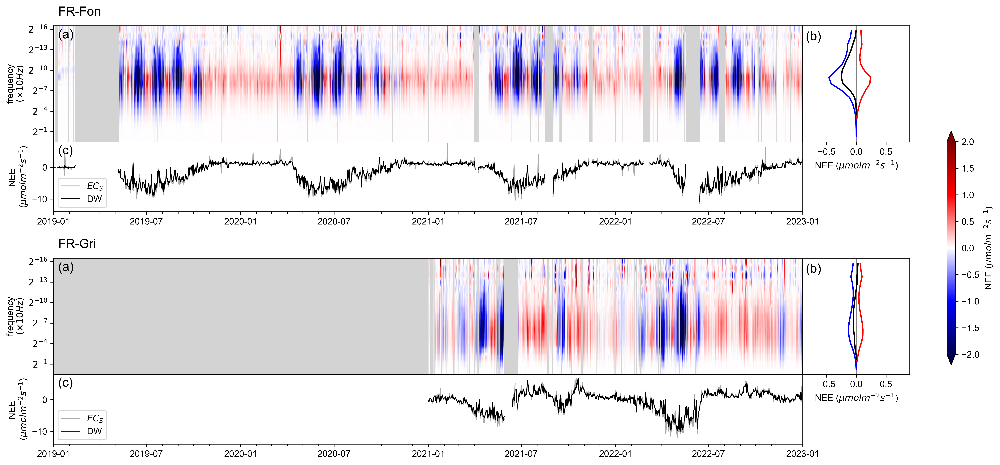

In [38]:
#chunkdfs = get_dic_flux_data(get_cospectra())
chunkdfs = get_dic_flux_data()

fig = plt.figure(figsize=(17, 9), dpi=600)
fig_grid = plt.GridSpec(19, 40)
plt.subplots_adjust(wspace=0, hspace=0)

_ax = []

for ix, (s, chunkdf) in enumerate(chunkdfs.items()):
    for c in range(18):
        if f"wco2_{c}" in chunkdf.columns:
            chunkdf.loc[:, f"wco2_{c}"] = chunkdf[f"wco2_{c}"] / chunkdf.Vd
    chunkdf = chunkdf.merge(pd.DataFrame(
        {"TIMESTAMP": pd.date_range(min(chunkdf.TIMESTAMP), max(chunkdf.TIMESTAMP), freq="30Min")}), how='outer', on="TIMESTAMP")
    chunkdf = chunkdf.sort_values('TIMESTAMP')
    NEEdaily = copy.deepcopy(
        chunkdf[['TIMESTAMP'] + [f"wco2_{c}" for c in range(14) if f"wco2_{c}" in chunkdf.columns]])
    NEEdaily['TIMESTAMP'] = NEEdaily.TIMESTAMP.dt.ceil('3D')
    NEEdaily = NEEdaily.groupby('TIMESTAMP').agg(np.mean).sum(axis=1).reset_index(drop=False)
    NEEdaily = NEEdaily[NEEdaily.TIMESTAMP < chunkdf.TIMESTAMP.max()]
    chunkdf = np.array([chunkdf.TIMESTAMP.to_list()] + [chunkdf[f"wco2_{c}"].to_list() for c in range(
        18) if f"wco2_{c}" in chunkdf.columns])
    
    #x0 = (pd.to_datetime("201901010000") - min(pd.to_datetime(chunkdf[0]))) / pd.Timedelta("30Min")
    #x1 = (pd.to_datetime("202301010000") - max(pd.to_datetime(chunkdf[0]))) / pd.Timedelta("30Min")
    xl = ['2019-01', '2019-07', '2020-01', '2020-07', '2021-01', '2021-07', '2022-01', '2022-07', '2023-01']
    d2x = lambda d: (pd.to_datetime(d) - min(pd.to_datetime(chunkdf[0]))) / pd.Timedelta("30Min")
    xb = [d2x(d+"-01 0000") for d in xl]

    # FIGURE A
    plt.subplot(fig_grid[(ix*9+ix):(ix*9+5+ix), :35])
    #plt.axhline(14.5, c='k', lw=1)
    cmap = matplotlib.cm.seismic
    cmap.set_bad('lightgray', 1.)
    _im = plt.imshow(chunkdf[1:].astype(float), aspect="auto",
                     origin='lower', vmin=-2, vmax=2, cmap=cmap)
    _ax += [plt.gca()]
    plt.text(d2x("20190110"), 18, s, size=14)
    plt.text(d2x("20190110"), 16, "(a)", size=14, va='top', ha='left')
    plt.ylabel('frequency\n'+r"$(\times10Hz)$")
    plt.yticks(np.arange(1, 18, 3), [
               r'$2^{-'+str(e)+'}$' for e in np.arange(1, 18, 3)])
    #print('NEEdaily', np.nansum(NEEdaily))
    #plt.gca().twinx().plot(np.arange(3*48/2, 3*48*(len(NEEdaily)+1/2),
    #                                 step=3*48), NEEdaily[0], color='k', lw=1)

    #if ix == 1:
    #    plt.xticks(xb, xl)
    #else:
    plt.xticks(xb, ['']*len(xb))

    # FIGURE C
    plt.subplot(fig_grid[(ix*9+5+ix):(ix*9+8+ix), :35])
    plt.text(pd.to_datetime("20190110"), 7, "(c)", size=14, va='top', ha='left')
    chunkdfs[s]['date'] = chunkdfs[s].TIMESTAMP.dt.date
    _statsdf = chunkdfs[s][['date', 'dwt_wco2', 'co2_flux']].groupby('date').agg([lambda x, q=n: np.quantile(
        x, q) for n in [0.01, 0.05, 0.25, 0.5, 0.75, 0.95, 0.99]]+[np.nanmean]).reset_index(drop=False)
    #plt.fill_between(_statsdf.date, _statsdf['dwt_wco2_x']['<lambda_1>'], _statsdf['dwt_wco2_x']['<lambda_5>'], color='C1', alpha=0.1, zorder=-9)
    #plt.fill_between(_statsdf.date, _statsdf['dwt_wco2_x']['<lambda_2>'], _statsdf['dwt_wco2_x']['<lambda_4>'], color='C1', alpha=0.3, zorder=-9)
    #plt.fill_between(_statsdf.date, _statsdf['co2_flux']['<lambda_1>'], _statsdf['co2_flux']['<lambda_5>'], color='C0', alpha=0.1, zorder=-9)
    #plt.fill_between(_statsdf.date, _statsdf['co2_flux']['<lambda_2>'], _statsdf['co2_flux']['<lambda_4>'], color='C0', alpha=0.3, zorder=-9)
    plt.plot(_statsdf.date, _statsdf['co2_flux']['nanmean'], color='C2', lw=1, label=r'$EC_S$')
    plt.plot(_statsdf.date, _statsdf['dwt_wco2']['nanmean'], color='k', lw=1, label=r'DW')
    #plt.plot(np.arange(3*48/2, 3*48*(len(NEEdaily)+1/2),
    #                                 step=3*48), NEEdaily[0], color='k', lw=1)
    xx = [pd.to_datetime(f'{yy}{str(mm).zfill(2)}01') for mm in range(1, 13) for yy in range(2019, 2023)]
    plt.gca().xaxis.set_minor_locator(matplotlib.ticker.FixedLocator(matplotlib.dates.date2num(xx)))
    plt.xlim(pd.to_datetime('20190101'), pd.to_datetime('20230101'))
    plt.ylim(-14, 8)
    plt.ylabel("NEE\n"+r"($μmolm^{-2}s^{-1}$)")
    plt.legend(loc='lower left')
    
    # FIGURE B
    plt.subplot(fig_grid[(ix*9+ix):(ix*9+5+ix), 35:])
    plt.text(-.85, 16, "(b)", size=14, va='top', ha='left')
    #plt.axhline(14.5, c='k', lw=1)
    plt.axvline(0, c='gray', lw=1)
    plt.plot(np.nanmean((chunkdf[1:].astype(float)), axis=1), np.arange(0, 17, 1), c="k")
    #plt.plot(np.nanmean(np.abs(chunkdf[1:].astype(float)), axis=1), np.arange(0, 17, 1), c="k", ls=":")
    plt.plot(np.nanmean((np.where(chunkdf[1:].astype(float) > 0, chunkdf[1:].astype(float), 0)), axis=1),
             np.arange(0, 17, 1),  c="red", ls="-")
    plt.plot(np.nanmean((np.where(chunkdf[1:].astype(float) < 0, chunkdf[1:].astype(float), 0)), axis=1),
             np.arange(0, 17, 1),  c="blue", ls="-")
    #plt.yticks(np.arange(1, 18, 3), [r'$2^{-'+str(e)+'}$' for e in np.arange(1, 18, 3)])
    #plt.yticks(np.arange(0, 17, 1), ['']*17)
    plt.yticks([])
    plt.xlim(-.9, .9)
    plt.xlabel(r"NEE ($μmolm^{-2}s^{-1}$)")
    #if ix == 0:
    #    plt.xticks([])
    
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
axins = inset_axes(plt.gca(),
                    width="0.8%",  
                    height="40%",
                    loc="center right",
                    borderpad=0,
                    bbox_to_anchor=(0,0,16*600,9*600)
                   )

_cb = plt.colorbar(_im, ax=_ax, cax=axins, pad=.08, shrink=0.7, aspect=40, extend="both")
_cb.set_label(r"NEE ($μmolm^{-2}s^{-1}$)")    

plt.show()

del chunkdfs, chunkdf, NEEdaily, _cb, _im, _ax


Figure 4

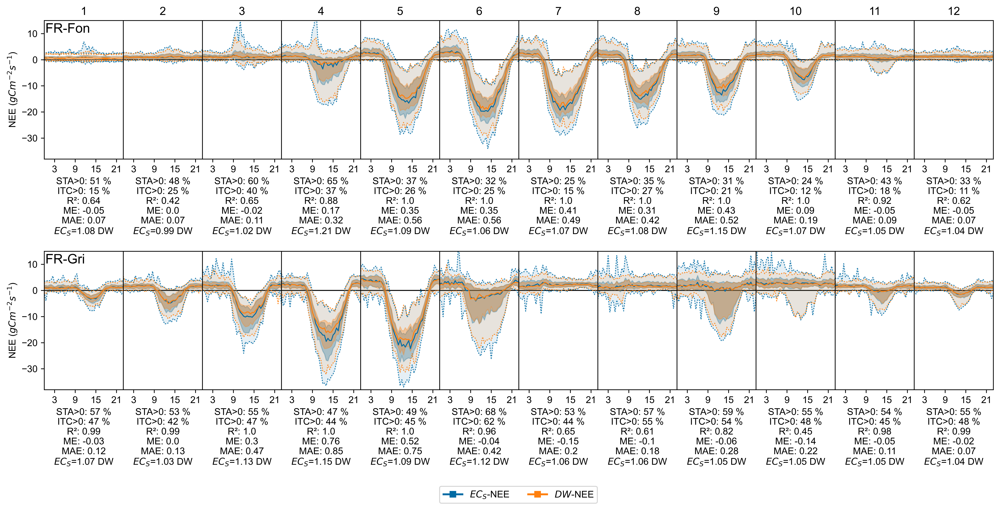

In [39]:
chunkdfs = get_dic_flux_data()

fig = plt.figure(figsize=(18, 9), dpi=600)
fig_grid = plt.GridSpec(4, 12, height_ratios=(3,2,3,2))
plt.subplots_adjust(wspace=0, hspace=0)

for ix, (s, chunkdf) in enumerate(chunkdfs.items()):
    chunkdf['month'] = chunkdf.TIMESTAMP.dt.month
    chunkdf['time'] = chunkdf.TIMESTAMP.dt.hour + chunkdf.TIMESTAMP.dt.minute/60

    for m in range(1,13):
        chunkMM = chunkdf[(chunkdf.month == m)]
        plt.subplot(fig_grid[ix*2, m-1])
        X = chunkMM.time.unique()
        
        plt.axhline(0, lw=1, color='k', zorder=-99)
        
        Ys = []
        options = {'o': ['co2_flux', "dwt_wco2"],
        'f': ["EP_NEE_uStar_f", "DWT_NEE_uStar_f"]}
        for i, ref in enumerate(options['o']):
            Yref = np.array([np.nanmedian(chunkMM[(chunkMM.time == x)][ref]) for x in X])
            Qr25 = np.array([np.nanquantile(chunkMM[(chunkMM.time == x)][ref], q=0.25) for x in X])
            Qr75 = np.array([np.nanquantile(chunkMM[(chunkMM.time == x)][ref], q=0.75) for x in X])
            Qr05 = np.array([np.nanquantile(chunkMM[(chunkMM.time == x)][ref], q=0.05) for x in X])
            Qr95 = np.array([np.nanquantile(chunkMM[(chunkMM.time == x)][ref], q=0.95) for x in X])
            #plt.fill_between(X, Qr05, Qr95, color=f'C{i}', alpha=0.1, zorder=-9)
            plt.plot(X, Qr05, c=f'C{i}', lw=1, ls=':', zorder=-8)
            plt.plot(X, Qr95, c=f'C{i}', lw=1, ls=':', zorder=-8)
            plt.fill_between(X, Qr05, Qr95, color=f'C{i}', alpha=0.1, zorder=-9)
            plt.fill_between(X, Qr25, Qr75, color=f'C{i}', alpha=0.3, zorder=-9)
            plt.plot(X, Yref, c=f'C{i}', lw=1, zorder=-8)
            Ys += [Yref]
        
        if ix==0: plt.title(m)

        plt.ylim(-38, 15)
        plt.xlim(0,23)
        plt.xticks([3, 9, 15, 21])
        #if ix==0:
        #    plt.xticks([])
        #plt.xlabel("")
        if m==1:
            plt.text(.3, 14, s, size=14, va='top', ha='left')
            plt.ylabel(r"NEE ($gCm^{-2}s^{-1}$)")
        else:
            plt.yticks([])
        
        pcSTA = round(100*(1-(sum(np.where(chunkMM['flag(w/co2)']<=2,1,0))/len(chunkMM))), 1)
        pcITC = round(100*(1-(sum(np.where(chunkMM['flag(w)']<=2,1,0))/len(chunkMM))), 1)
        plt.subplot(fig_grid[ix*2+1, m-1])
        statslabel = summarisestatslabel(summarisestats(Ys[1], Ys[0]), 'DW', r'$EC_S$')
        statslabel = f'STA>0: {int(pcSTA)} %\nITC>0: {int(pcITC)} %\n' + statslabel
        plt.text(0.5, .8, statslabel, size=10, va='top', ha='center')
        #plt.xlim(0,23)
        #plt.ylim(-38, 15)
        plt.axis('off')

        if m == 6:
            if ix == (len(chunkdfs)-1):
                #plt.legend(title="")
                plt.legend([pltline2d([0], [0], marker='s', color=f"C{c}", lw=2) for c in range(2)], 
                [r'$EC_S$-NEE', r'$DW$-NEE'], loc=(0,-0.23), ncols=2)

        del chunkMM

del chunkdf


Figure 5

C:\Users\PHHERI~1\AppData\Local\Temp/ipykernel_3656/3418968747.py:36: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  plt.plot("date", compare[i], data=chunkdf.groupby(
C:\Users\PHHERI~1\AppData\Local\Temp/ipykernel_3656/3418968747.py:36: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  plt.plot("date", compare[i], data=chunkdf.groupby(
C:\Users\PHHERI~1\AppData\Local\Temp/ipykernel_3656/3418968747.py:59: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should 

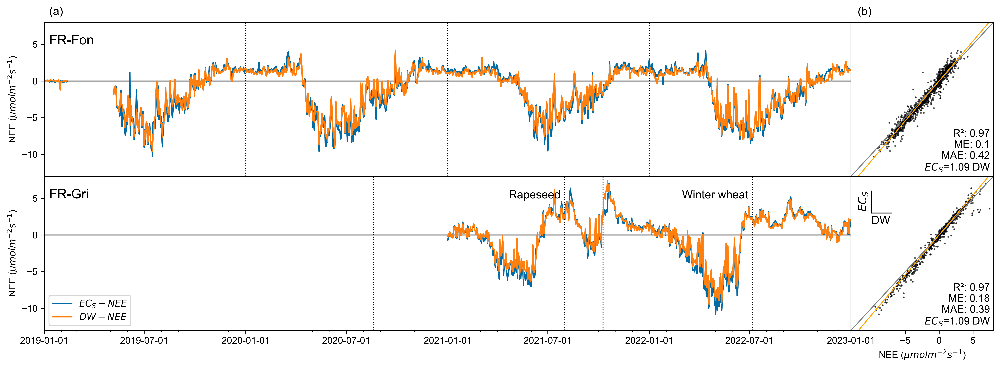

In [40]:
chunkdfs = get_dic_flux_data()

fig = plt.figure(figsize=(18, 9), dpi=600)
fig_grid = plt.GridSpec(3, 20)
plt.subplots_adjust(wspace=0, hspace=0)

#chunkdf["CWT_NEE_uStar_f2"] = np.nansum(chunkdf[[v for k, v in fluxData.freq_cwt.items() if ((1/k) < (60*30))]], axis=1)

#compare = ("co2_flux", "dwt_co2w")  # , "cwt_co2w")
compare = ("EP_NEE_uStar_f", "DWT_NEE_uStar_f")  # , "CWT_NEE_uStar_f")
labels = ["EC_S-NEE", "DW-NEE", "CW-NEE"]
cunit = [(1/10**6) * (30*60)] * 3
ccolors = [f"C{i}" for i in range(len(compare))]

for ix, (s, chunkdf) in enumerate(chunkdfs.items()):
    chunkdf['date'] = chunkdf.TIMESTAMP.dt.date
    chunkdf["DW_NEE"] = chunkdf[chunkdf.columnsmatch('dwt_wco2..wh2o_uStar_f')].sum(axis=1)

    plt.subplot(fig_grid[ix, :17])
    plt.axhline(0, c='k', lw=1)
    #chunkdf[compare[1]] = np.where(np.abs(chunkdf[compare[1]])>60, 0, chunkdf[compare[1]])
    if s=="FR-Gri":
        sea0 = [pd.to_datetime("20200819"), pd.to_datetime("20210731"), pd.to_datetime("20211009"),  pd.to_datetime("20220706")]
        #sea1 = [pd.to_datetime("20210301"), pd.to_datetime("20210731"), pd.to_datetime("20220301"),  pd.to_datetime("20220706")]
        [plt.text(pd.to_datetime(c['harvest']) - pd.Timedelta('7 days'), 5, c['name'], size=12, ha='right') for c in FRGriCalendar.values()]
    else:
        sea0 = [pd.to_datetime(f"{y}01010000") for y in range(2019, 2023)]
    for s_ in sea0:
        plt.axvline(s_, c="k", ls=":", lw=1)
    for i, c in enumerate(compare):
        if c.startswith("EP_NEE_uStar_f"):
            chunkdf['co2-randerr'] = chunkdf[c] - chunkdf.rand_err_co2_flux
            chunkdf['co2+randerr'] = chunkdf[c] + chunkdf.rand_err_co2_flux
            #plt.fill_between("date", 'co2-randerr', 'co2+randerr', data=chunkdf.groupby(
            #    "date").agg(np.nanmean).reset_index(), label=compare[i].split("_")[0], alpha=0.6)
        plt.plot("date", compare[i], data=chunkdf.groupby(
            "date").agg(np.nanmean).reset_index(), label=r'$'+labels[i]+'$', c=ccolors[i])
    #plt.xlim(tt.minmax(chunkdf.TIMESTAMP))
    plt.text(pd.to_datetime('20190110'), 5, s, size=14)
    if ix==0: plt.text(pd.to_datetime('20190110'), 9, "(a)", size=12)
    plt.xlim(pd.to_datetime('20190101'), pd.to_datetime('20230101'))
    plt.ylim(-13, 8)
    plt.ylabel('NEE 'r"($μmolm^{-2}s^{-1}$)")
    if ix < (len(chunkdfs)-1):
        plt.xticks([])
    else:
        xl = ['2019-01', '2019-07', '2020-01', '2020-07', '2021-01', '2021-07', '2022-01', '2022-07', '2023-01']
        plt.xticks([pd.to_datetime(d+"-01 0000") for d in xl])
        xx = [pd.to_datetime(f'{yy}{str(mm).zfill(2)}01') for mm in range(1, 13) for yy in range(2019, 2023)]
        plt.gca().xaxis.set_minor_locator(matplotlib.ticker.FixedLocator(matplotlib.dates.date2num(xx)))
        plt.legend(loc='lower left')

    plt.subplot(fig_grid[ix, 17:])
    #chunkdf = chunkdfs[s]
    #chunkdf["date"] = chunkdf.TIMESTAMP.dt.ceil('30Min')
    #chunkdf = chunkdf.groupby("date").agg(np.nanmean).reset_index()
    #plt.scatter(chunkdf[compare[0]], chunkdf[compare[1]], s=1, c='k', alpha=0.6)
    #plt.scatter(compare[0], compare[1], data=chunkdf.groupby("date").agg(np.nanmean).reset_index(), s=1, c='k', alpha=0.6)
    plt.scatter(compare[1], compare[0], data=chunkdf.groupby("date").agg(np.nanmean).reset_index(), s=1, c='k', alpha=0.6)
    #r2 = chunkdf[["date"] + list(compare)].groupby("date").agg(np.nanmean).corr()[compare[0]][compare[1]]
    y, X = [np.array(chunkdf[["date"] + list(compare)].dropna().groupby("date").agg(
        np.nanmean)[compare[c]]) for c in range(2)]
    stat = summarisestats(X, y)
    plt.plot([-13, 8], [-13, 8], lw=1, c='gray')
    plt.plot([-13, 8], [-13*stat.m+stat.b, 8*stat.m+stat.b], lw=1, c='orange')
    stat_label = summarisestatslabel(stat, 'DW', r'$EC_S$')
    plt.text(7.5, -12.5, stat_label, size=11, ha='right', va='bottom')

    plt.ylim(-13, 8)
    plt.xlim(-13, 8)
    plt.yticks([])
    if ix==0: plt.text(-12, 9, "(b)", size=12)
    if ix < (len(chunkdfs.keys())-1):
        plt.xticks([])
    else:
        plt.plot([-10, -10], [3, 6], 'k', lw=1)
        plt.text(-12, 3.5, r"$EC_S$", size=12, rotation=90)
        plt.plot([-10, -7], [3, 3], 'k', lw=1)
        plt.text(-10, 1.5, "DW", size=12)
        plt.xticks([-5,0,5])
        plt.xlabel('NEE 'r"($μmolm^{-2}s^{-1}$)")


plt.show()

del chunkdfs, chunkdf, X, y


Figure 6, 7

In [92]:
all_flux_data.columnstartswith('TA')


['TA',
 'TA_1',
 'TA_2',
 'TA_3',
 'TA_4',
 'TA_5',
 'TA_6',
 'TA_1_1_2',
 'TA_3_1_1',
 'TA_2_4_1',
 'TA_2_3_1',
 'TA_2_2_1',
 'TA_2_1_1',
 'TA_1_1_1',
 'TA_4_1_1',
 'TA_1_3_1',
 'TA_1_2_1']

C:\Users\PHHERI~1\AppData\Local\Temp/ipykernel_3656/3755028683.py:69: RuntimeWarning: Mean of empty slice
  chunkdf['_P'] = np.nanmean(
C:\Users\PHHERI~1\AppData\Local\Temp/ipykernel_3656/3755028683.py:73: RuntimeWarning: Mean of empty slice
  chunkdf['_TA'] = np.nanmean(
C:\Users\PHHERI~1\AppData\Local\Temp/ipykernel_3656/3755028683.py:90: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  chunkdf = chunkdf.groupby(
C:\Users\PHHERI~1\AppData\Local\Temp/ipykernel_3656/3755028683.py:69: RuntimeWarning: Mean of empty slice
  chunkdf['_P'] = np.nanmean(
C:\Users\PHHERI~1\AppData\Local\Temp/ipykernel_3656/3755028683.py:71: RuntimeWarning: Mean of empty slice
  chunkdf['_PPFD'] = np.nanmean(


Tair 95th 2019-06-27 00:00:00 2019-07-24 00:00:00 2019-07-25 00:00:00 2019-07-26 00:00:00
	 26.94043998015873 27.23446130952381 29.836511904761906 31.760904265873013
Tair 95th 2020-08-01 00:00:00 2020-08-08 00:00:00 2020-08-09 00:00:00 2020-08-10 00:00:00
	 27.75324826388889 27.08638318452381 28.174150049603174 26.29596626984127
Tair 95th 2021-06-17 00:00:00 2021-07-24 00:00:00 2021-08-16 00:00:00 2021-09-09 00:00:00
	 24.429551819444445 22.589897418981483 22.513029615740738 22.50068024074074
Tair 95th 2022-06-19 00:00:00 2022-07-19 00:00:00 2022-07-20 00:00:00 2022-08-04 00:00:00
	 26.85044358796296 26.655844017094015 29.73458947916667 25.863086976686507


C:\Users\PHHERI~1\AppData\Local\Temp/ipykernel_3656/3755028683.py:73: RuntimeWarning: Mean of empty slice
  chunkdf['_TA'] = np.nanmean(
C:\Users\PHHERI~1\AppData\Local\Temp/ipykernel_3656/3755028683.py:75: RuntimeWarning: Mean of empty slice
  chunkdf['_TS_1'] = np.nanmean(
C:\Users\PHHERI~1\AppData\Local\Temp/ipykernel_3656/3755028683.py:77: RuntimeWarning: Mean of empty slice
  chunkdf['_TS_2'] = np.nanmean(
C:\Users\PHHERI~1\AppData\Local\Temp/ipykernel_3656/3755028683.py:79: RuntimeWarning: Mean of empty slice
  chunkdf['_TS_3'] = np.nanmean(
C:\Users\PHHERI~1\AppData\Local\Temp/ipykernel_3656/3755028683.py:81: RuntimeWarning: Mean of empty slice
  chunkdf['_TS_4'] = np.nanmean(
C:\Users\PHHERI~1\AppData\Local\Temp/ipykernel_3656/3755028683.py:90: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.


Tair 95th
	
Tair 95th 2020-12-23 00:00:00
	 14.186946334201389
Tair 95th 2021-06-17 00:00:00 2021-07-20 00:00:00 2021-07-21 00:00:00 2021-07-22 00:00:00
	 24.00931965798611 23.59618398611111 22.90492861371528 22.802986999131946
Tair 95th 2022-06-19 00:00:00 2022-07-14 00:00:00 2022-07-19 00:00:00 2022-07-20 00:00:00
	 28.216479651909722 27.840649014322917 28.27995370311764 29.68062279644097


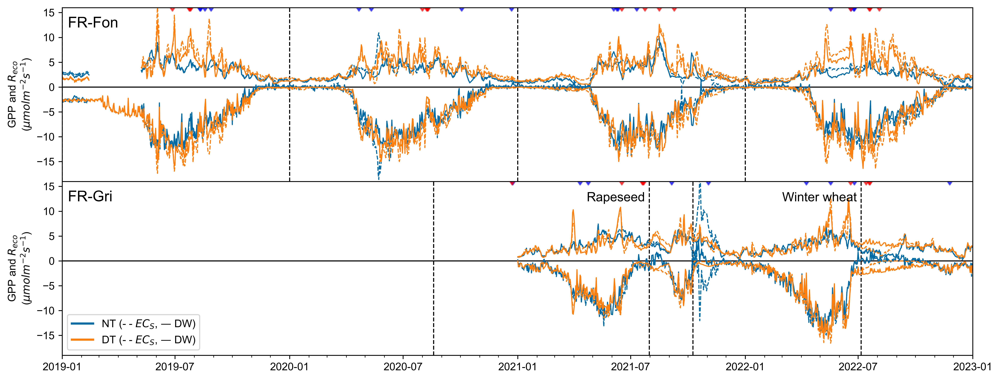

In [93]:
# SWITCH
opt = 'fig6'

# SCRIPT
chunkdfs = get_dic_flux_data()

fig = plt.figure(figsize=(18, 9), dpi=600)
fig_grid = plt.GridSpec(3, 20)
plt.subplots_adjust(wspace=0, hspace=0)

t_avg = "1D"

xx = [pd.to_datetime(f'{yy}{str(mm).zfill(2)}01') for mm in range(1, 13) for yy in range(2019, 2023)]
xb = [d.strftime('%Y-%m') if d.month in (1,7) and d.year < 2023 else '' for d in xx]
#xx = [d if d.month in (1,7) and d.year < 2023 else '' for d in xx]

def get_r2(X, y):
    if len(X)==0:
        return 0
    X = np.array(X).ravel()
    y = np.array(y).ravel()
    finite = np.isfinite(X*y)
    X = X[finite].reshape(-1, 1)
    y = y[finite].reshape(-1, 1)
    regression = LinearRegression(fit_intercept=True)
    regression.fit(X, y)
    r2 = regression.score(X, y)
    return r2

#compare = ("EP_NEE_uStar_f", "DWT_NEE_uStar_f")
class optionToPlot:
    def __init__(self):
        self.items = {}
    def parsekw(self, kw):
        return {'var': kw['var'], 'lab': kw.get('lab', kw.get('var')), 
        'unit': kw.get('unit', [(1/10**6) * (30*60),]*len(kw.get('var'))),
        'cs': kw.get('cs', [f"C{i}" for i in range(len(kw.get('var'))//2)] * 2),
        'ls': kw.get('ls', ["-"]*len(kw.get('var')))}
    def add(self, idx, var, lab, **kw):
        kw.update({'var': var, 'lab': lab})
        self.items.update({idx: structuredData(**self.parsekw(kw))})
    def get(self, idx):
        return self.items.get(idx)

def parsekw(**kw):
    return {'var': kw['var'], 'lab': kw.get('lab', kw.get('var')), 
    'unit': kw.get('unit', [(1/10**6) * (30*60),]*len(kw.get('var'))),
    'cs': kw.get('cs', [f"C{i}" for i in range(len(kw.get('var'))//2)] * 2),
    'ls': kw.get('ls', ["-"]*len(kw.get('var')))}


#lightresponse = lambda p, k=1, m=1, b=0: abs(b-max(min(k, 1), 0)*p/np.nanquantile(p, min(m, 1)))
#lightresponse = lambda p, m=1200, k=0.9, b=0: np.where(p>50, abs(b-k*(1-1/(1+p/m))/np.nanmax(1-1/(1+p/m))), 0)
lightresponse = lambda p, k=1, m=1, b=0: np.where(np.isnan(p), 1, (p-np.nanmin(p))/(np.nanmax(p)-np.nanmin(p)))

options = {}
options.update({'figsx': parsekw(var=("EP_GPP_TKF_uStar",    "EP_GPP_MRF_uStar",     "EP_Reco_TKF_uStar",    "EP_Reco_MRF_uStar"), lab=("DT", 'NT'))})
options.update({'figx': parsekw(var=("EP_GPP_TKF_uStar",    "EP_GPP_MRF_uStar",     "EP_Reco_TKF_uStar",    "EP_Reco_MRF_uStar"), lab=("DT", 'NT'))})
options.update({'figy': parsekw(var=("EP_GPP_MRF_uStar", "EP_GPP_TKF_uStar", "DW_NEE_DW_-", "EP_Reco_MRF_uStar", "EP_Reco_TKF_uStar", "DW_NEE_DW_+"), lab=("NT", "DT", 'DW'))})
options.update({'fig7': parsekw(var=("DW_GPP_MRF_uStar",   "DW_GPP", "DW_Reco_MRF_uStar", "DW_Reco"), lab=("NT", "DW"))})
options.update({'fig6': parsekw(var=("EP_GPP_MRF_uStar",   "DW_GPP_MRF_uStar",     "EP_GPP_TKF_uStar",     "DW_GPP_TKF_uStar", 
          "EP_Reco_MRF_uStar",  "DW_Reco_MRF_uStar",    "EP_Reco_TKF_uStar",    "DW_Reco_TKF_uStar"), lab=(r"NT (- - $EC_S$, — DW)", r"DT (- - $EC_S$, — DW)"),
          cs=[f"C{i}" for i in [0,0,1,1]] * 2, ls=["--", "-"] * 4)})

compare, clabels, cunit, ccolors, lls = options.get(opt).values()
clabels_ = [c.split(' ')[0] for c in clabels]

for ix, (s, chunkdf) in enumerate(chunkdfs.items()):
    chunkdf['_P'] = np.nanmean(
        chunkdf[chunkdf.columnstartswith('P_')], axis=1)
    chunkdf['_PPFD'] = np.nanmean(
        chunkdf[chunkdf.columnstartswith('PPFD_BC_IN')], axis=1)
    chunkdf['_TA'] = np.nanmean(
        chunkdf[chunkdf.columnstartswith('TA')], axis=1)
    chunkdf['_TS_1'] = np.nanmean(
        chunkdf[chunkdf.columnstartswith('TS_1')], axis=1)
    chunkdf['_TS_2'] = np.nanmean(
        chunkdf[chunkdf.columnstartswith('TS_2')], axis=1)
    chunkdf['_TS_3'] = np.nanmean(
        chunkdf[chunkdf.columnstartswith('TS_3')], axis=1)
    chunkdf['_TS_4'] = np.nanmean(
        chunkdf[chunkdf.columnstartswith('TS_4')], axis=1)
    
    chunkdf["date"] = chunkdf.TIMESTAMP.dt.ceil(t_avg)

    # correct GPP sign
    for c in [f"{i}_GPP_{m}_uStar" for i in ["EP", "DW"] for m in ["MRF", "TKF", "GLF"]]:
        chunkdf[c] = (-2*(np.nanmean(chunkdf[c])>0)+1) * chunkdf[c]
    
    chunkdf = chunkdf.groupby(
        "date").agg(np.nanmean).reset_index()
    
    plt.subplot(fig_grid[ix, :17])
    plt.axhline(0, c='k', lw=1)

    # add vertical reference lines
    if s=="FR-Gri":
        sea0 = [pd.to_datetime("20200819"), pd.to_datetime("20210731"), pd.to_datetime("20211009"),  pd.to_datetime("20220706")]
        #sea1 = [pd.to_datetime("20210301"), pd.to_datetime("20210731"), pd.to_datetime("20220301"),  pd.to_datetime("20220706")]
        [plt.text(pd.to_datetime(c['harvest']) - pd.Timedelta('7 days'), 12, c['name'], size=12, ha='right') for c in FRGriCalendar.values()]
    else:
        sea0 = [pd.to_datetime(f"{y}01010000") for y in range(2019, 2023)]
    for s_ in sea0:
        plt.axvline(s_, c="k", ls="--", lw=1)
    sea0 = sea0 + [pd.to_datetime('20230101')]

    """
    # Annual Corr Stats (R²) top
    sea0 = [pd.to_datetime(f"{y}{m}010000") for m in ["03", "06", "09", "12"] for y in range(2019, 2023)]
    for i, s_ in enumerate(sea0[:-1]):
        plt.text(sea0[i+1] - pd.Timedelta("10D"), 12, 
        'R²: {}'.format(np.round(get_r2(chunkdf[(chunkdf["date"]>=s_) * (chunkdf["date"]<sea0[i+1])][compare[1]], 
                                        chunkdf[(chunkdf["date"]>=s_) * (chunkdf["date"]<sea0[i+1])][compare[0]]), 2)), 
                size=14, horizontalalignment='right')
    """

    for i, c in enumerate(compare):
        plt.plot("date", compare[i], data=chunkdf, c=ccolors[i], ls=lls[i], lw=1.)
    
    if opt == 'fig6':
        # add climate (↓)
        for y in range(2019, 2023):
        #for mm in [(12,1,2), (3,4,5), (6,7,8), (9,10,11)]:
            chdfy = chunkdf[chunkdf.date.dt.year == y] #chunkdf.month.isin(mm)
            #print([np.nanquantile(chdfy.P, q/100) for q in [0,1,5,25,50,75,95,99,100]])
            plt.scatter(chdfy.date, np.where((chdfy._P*48)>np.nanquantile(chdfy._P*48, .99), 16, np.nan), c='blue', alpha=0.6, s=15, marker=11)
            #[plt.axvline(d, c='gray', alpha=0.1) for d in chdfy[np.where((chdfy.P*48)>np.nanquantile(chdfy.P*48, .95), True, False)].date]
            #print('Tair 95th', np.nanquantile(chdfy.Tair_f, .95))
            plt.scatter(chdfy.date, np.where((chdfy._TA)>np.nanquantile(chdfy._TA, .99), 16, np.nan), c='red', alpha=0.6, s=15, marker=11)
            print('Tair 95th', *[d for d in chdfy[np.where((chdfy._TA)>np.nanquantile(chdfy._TA, .99), True, False)].date])
            print('\t', *[d for d in chdfy[np.where((chdfy._TA)>np.nanquantile(chdfy._TA, .99), True, False)]._TA])
            #plt.scatter(fluxDatas[s].fdata.TIMESTAMP, np.where(fluxDatas[s].fdata.P>0.3, 16, np.nan), c='blue', s=30, marker='x')
            #plt.scatter(fluxDatas[s].fdata.TIMESTAMP, np.where(fluxDatas[s].fdata.Tair_f>35, 16, np.nan), c='red', s=30, marker='x')
    
    plt.text(pd.to_datetime('20190110'), 12, s, size=14)
    if ix==0 and len(compare)<=4: plt.text(pd.to_datetime('20190110'), 17, "(a)", size=12)
    plt.xlim(pd.to_datetime('20190101'), pd.to_datetime('20230101'))
    plt.ylim(-19, 16)
    plt.ylabel('GPP and '+r"$R_{eco}$"+'\n'+r"($μmolm^{-2}s^{-1}$)")
    #plt.ylabel('NEE\n'+r"($μmolm^{-2}s^{-1}$)")
    """
    # Error Stats bottom left
    plt.text(pd.to_datetime('20190110'), -17, "ME ({}) = {} (Reco), {} (GPP)\nMAE ({}) = {} (Reco), {} (GPP)".format(
        r"$μmolm^{-2}s^{-1}$",
        np.nanmean((chunkdf.EP_Reco_uStar - chunkdf[compare[3]])).round(1),
        np.nanmean((-chunkdf.EP_GPP_uStar_f - chunkdf[compare[1]])).round(1), 
        r"$μmolm^{-2}s^{-1}$",
        np.nanmean(np.abs(chunkdf.EP_Reco_uStar - chunkdf[compare[3]])).round(1),
        np.nanmean(np.abs(-chunkdf.EP_GPP_uStar_f - chunkdf[compare[1]])).round(1)), size=12)
    """

    if ix == 0:
        plt.xticks([])
    else:
        plt.gca().xaxis.set_minor_locator(matplotlib.ticker.FixedLocator(matplotlib.dates.date2num(firstOfEveryMonth)))
    if ix == (len(chunkdfs)-1):
        plt.legend([pltline2d([0], [0], color=ccolors[i], ls=lls[i], lw=2) for i in np.arange(int(len(ccolors)/len(clabels)/2)-1, len(ccolors), step=int(len(ccolors)/len(clabels)/2))], 
        [c for c in clabels], #title=r'$R_{eco}$ (+) GPP (-)',
            loc='lower left')
        """
        # legend for Reco and GPP 
        plt.gca().twinx().legend([pltline2d([0], [0], color="C0", lw=2), 
        pltline2d([0], [0], color="C1", lw=2), ], [
            r'$NT-Reco$', r'$DW-Reco$'], loc='upper right')
        plt.yticks([])
        """
    
    # skip scatter regression plot
    if len(compare)>4:
        continue

    plt.subplot(fig_grid[ix, 17:])
    plt.scatter(x=compare[1], y=compare[0], data=chunkdf, s=1, c='k', alpha=0.6)
    plt.scatter(x=compare[3], y=compare[2], data=chunkdf, s=1, c='k', alpha=0.6)
    plt.plot([-20, 16], [-20, 16], lw=1, c='gray')
    '''
    for i_ in [0, 2]:
        y, X = [np.array(chunkdf.dropna(
            subset=[compare[0+i_], compare[1+i_]])[compare[c+i_]]) for c in range(2)]
    '''
    scd = chunkdf.dropna(subset=[compare[i] for i in range(4)])
    X = np.array(pd.concat([scd[compare[1]], scd[compare[3]]]))
    y = np.array(pd.concat([scd[compare[0]], scd[compare[2]]]))
    me = np.nanmean((X-y)).round(2)
    mae = np.nanmean(abs(X-y)).round(2)
    regression = LinearRegression(fit_intercept=False)
    regression.fit(X.reshape(-1, 1), y.reshape(-1, 1))
    m = regression.coef_[0][0]
    b = regression.intercept_
    b_ = np.round(b[0], 2) if b else 0
    b_ = "+" + str(b_) if b_ >= 0 else str(b_)
    r2 = regression.score(X.reshape(-1, 1), y.reshape(-1, 1))
    
    plt.plot([-20, 20], [-20*m+b, 20*m+b], lw=1, c='orange')
    stat_label = f"R²: {np.round(r2, 2)}"
    stat_label = stat_label + f"\nME: {np.round(me, 2)}"
    stat_label = stat_label + f"\nMAE: {np.round(mae, 2)}"
    stat_label = stat_label + f"\n{clabels[0]}={np.round(m, 2)}"+r'$\times$'+f"{clabels[1]}"#{b_}"
    
    plt.text(15.5, -18.5, stat_label, size=11, horizontalalignment='right', verticalalignment='bottom')

    plt.ylim(-19, 16)
    plt.xlim(-19, 16)
    plt.yticks([])
    if ix==0: plt.text(-18, 17, "(b)", size=12)
    if ix < (len(chunkdfs.keys())-1):
        plt.xticks([])
    else:
        plt.plot([-14, -14], [7, 11], 'k', lw=1)
        plt.text(-17., 7.5, clabels[0], size=12, rotation=90)
        plt.plot([-14, -10], [7, 7], 'k', lw=1)
        plt.text(-14, 4.5, clabels[1], size=12)
        plt.xticks([-10, 0, 10])
        plt.xlabel('GPP and '+r"$R_{eco}$"+'\n'+r"($μmolm^{-2}s^{-1}$)")
        #plt.xlabel('NEE\n'+r"($μmolm^{-2}s^{-1}$)")

del chunkdfs, chunkdf


Figure 8

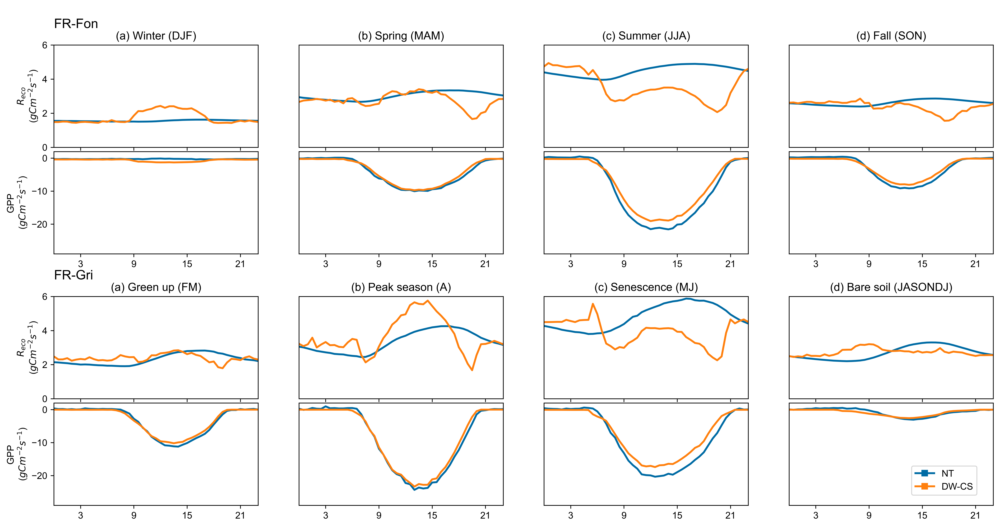

In [43]:
chunkdfs = get_dic_flux_data()#all_flux_data.merge(get_partitioning(), on='TIMESTAMP', how='outer', suffixes=('', '_PT')))

seasonLabel = {'FR-Fon': {1: "(a) Winter (DJF)", 2: "(b) Spring (MAM)", 3: "(c) Summer (JJA)", 4: "(d) Fall (SON)"},
    'FR-Gri': {1: "(a) Green up (FM)", 2: "(b) Peak season (A)", 3: "(c) Senescence (MJ)", 4: "(d) Bare soil (JASONDJ)"}}

#optionsMenu = optionToPlot()
#optionsMenu.add(1, {'Reco': ['EP_Reco_MRF_uStar', "DW_Reco"], 'GPP': ["EP_GPP_MRF_uStar", "DW_GPP"]}, ("NT", 'DWCS'))
#optionsMenu.add(2, {'Reco': ['DW_NEE_DW_++', 'DW_NEE_DW_+-'], 'GPP': ['DW_NEE_DW_-+', 'DW_NEE_DW_--']}, (r"$φ_v^+$", r"$φ_v^-$"))

options, clabels = [{'Reco': ['EP_Reco_MRF_uStar', "DW_Reco"], 'GPP': ["EP_GPP_MRF_uStar", "DW_GPP"]}, ("NT", 'DW-CS')]

fig = plt.figure(figsize=(18, 14), dpi=600)
fig_grid = plt.GridSpec(8, 4, height_ratios=(1,3,3,1,3,3,3,3))
plt.subplots_adjust(wspace=0.2, hspace=0.05)

for ix, (s, chunkdf) in enumerate(chunkdfs.items()):
    v = "HOD"
    chunkdf['HOD'] = chunkdf.TIMESTAMP.dt.hour
    chunkdf['month'] = chunkdf.TIMESTAMP.dt.month
    chunkdf['year'] = chunkdf.TIMESTAMP.dt.year

    chunkdf['season'] = chunkdf.month.apply(month2season)
    if s=='FR-Gri':
        chunkdf['season'] = np.where(chunkdf.month==1, 4, chunkdf.season)
        chunkdf['season'] = np.where(chunkdf.month==2, 1, chunkdf.season)
        chunkdf['season'] = np.where(chunkdf.month==3, 1, chunkdf.season)
        chunkdf['season'] = np.where(chunkdf.month==4, 2, chunkdf.season)
        chunkdf['season'] = np.where(chunkdf.month==5, 3, chunkdf.season)
        chunkdf['season'] = np.where(chunkdf.month==6, 3, chunkdf.season)
        chunkdf['season'] = np.where(chunkdf.month> 6, 4, chunkdf.season)
        chunkdf['season'] = np.where((chunkdf.year==2021) * (chunkdf.month==9), 0, chunkdf.season)
    chunkdf['time'] = chunkdf.TIMESTAMP.dt.hour + chunkdf.TIMESTAMP.dt.minute/60
    #chunkdf['index'] = ["GPP" if v in ['dwt_wco2+-h2o', "dwt_wco2++h2o"] else "Reco" if v in ['dwt_wco2--h2o', "dwt_wco2-+h2o"] else "" for v in chunkdf.variable]
    
    plt.subplot(fig_grid[ix*3, :])
    plt.text(0, 0.3, s, size=14, va='bottom', ha='left')
    plt.axis('off')
    for m in range(1,5):
        chunkMM = chunkdf[(chunkdf.season == m)].reset_index(drop=True)
        for c in chunkMM.columnsmatch('.+_GPP_.{3}_uStar'):
            chunkMM[c] = -chunkMM[c]

        for j, (key, refs) in enumerate(options.items()):
            plt.subplot(fig_grid[1+3*ix+j, m-1])
            X = chunkMM.time.unique()
            X.sort()
            
            Ys = []
            for i, ref in enumerate(refs):
                Yref = np.array([np.nanmean(chunkMM[(chunkMM.time == x)][ref]) for x in X])
                Ymed = np.array([np.nanmedian(chunkMM[(chunkMM.time == x)][ref]) for x in X])
                Qr25 = np.array([np.nanquantile(chunkMM[(chunkMM.time == x)][ref], q=0.25) for x in X])
                Qr75 = np.array([np.nanquantile(chunkMM[(chunkMM.time == x)][ref], q=0.75) for x in X])
                Qr05 = np.array([np.nanquantile(chunkMM[(chunkMM.time == x)][ref], q=0.05) for x in X])
                Qr95 = np.array([np.nanquantile(chunkMM[(chunkMM.time == x)][ref], q=0.95) for x in X])
                StDv = np.array([np.nanstd(chunkMM[(chunkMM.time == x)][ref]) for x in X])
                #plt.fill_between(X, Qr05, Qr95, color=f'C{i}', alpha=0.1, zorder=-9)
                #plt.plot(X, Qr05, c=f'C{i}', lw=1, ls=':', zorder=-8)
                #plt.plot(X, Qr95, c=f'C{i}', lw=1, ls=':', zorder=-8)
                #plt.fill_between(X, Qr05, Qr95, color=f'C{i}', alpha=0.1, zorder=-9)
                #plt.fill_between(X, Qr25, Qr75, color=f'C{i}', alpha=0.3, zorder=-9)
                #plt.fill_between(X, Yref-StDv, Yref+StDv, color=f'C{j}', alpha=0.2, lw=0, zorder=-9)
                plt.plot(X, Yref, c=f'C{i}', lw=2, zorder=-8)
                Ys += [Yref]
                
            if j==0: plt.title(seasonLabel[s][m])

            if key=='Reco': plt.ylim(0, 6)
            elif key=='GPP': plt.ylim(-29, 2)
            else: plt.ylim(-29, 9)
            plt.xlim(0,23)
            plt.xticks([3, 9, 15, 21])
            #if ix==0:
            #    plt.xticks([])
            #plt.xlabel("")
            if m==1:
                #plt.text(.2, 12, s, size=14, va='top', ha='left')
                #plt.text(.3, 14, key, size=12, va='top', ha='left')
                if j==0: plt.ylabel(r"$R_{eco}$"+'\n'+r"($gCm^{-2}s^{-1}$)")
                if j==1: plt.ylabel(r"GPP"+'\n'+r"($gCm^{-2}s^{-1}$)")
            else:
                plt.yticks([])
        
        if m == 4:
            if ix == (len(chunkdfs)-1):
                #plt.legend(title="")
                plt.legend([pltline2d([0], [0], marker='s', color=f"C{c}", lw=2) for c in range(2)], 
                clabels, loc=(0.6,0.1), ncols=1)

        del chunkMM

del chunkdf, v


Figure 9

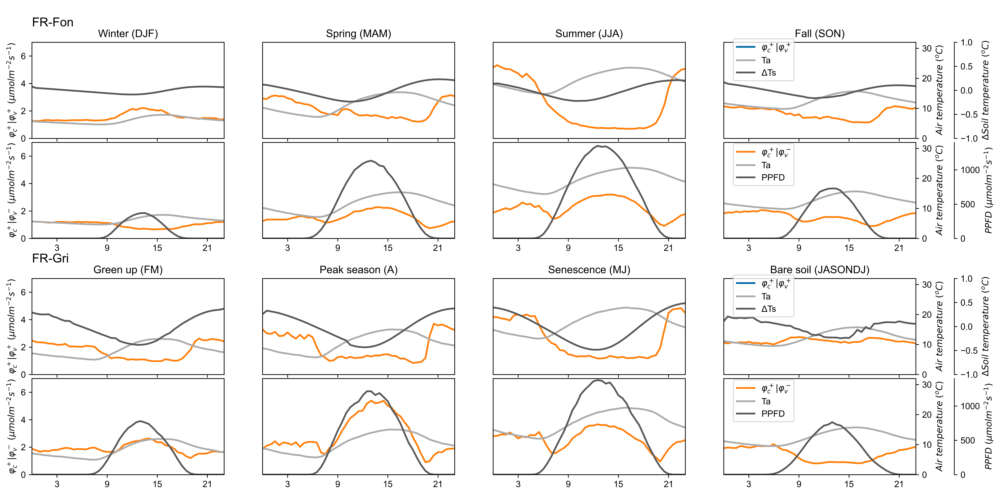

In [44]:
chunkdfs = get_dic_flux_data()#all_flux_data.merge(get_biomet(), on=['co_site', 'TIMESTAMP'], how='outer', suffixes=('', '_BM')))

seasonLabel = {'FR-Fon': {1: "Winter (DJF)", 2: "Spring (MAM)", 3: "Summer (JJA)", 4: "Fall (SON)"},
    'FR-Gri': {1: "Green up (FM)", 2: "Peak season (A)", 3: "Senescence (MJ)", 4: "Bare soil (JASONDJ)"}}

fig = plt.figure(figsize=(18, 14), dpi=600)
fig_grid = plt.GridSpec(8, 4, height_ratios=(1,3,3,1,3,3,3,3))
plt.subplots_adjust(wspace=0.2, hspace=0.05)

for ix, (s, chunkdf) in enumerate(chunkdfs.items()):
    v = "HOD"
    chunkdf['HOD'] = chunkdf.TIMESTAMP.dt.hour
    chunkdf['month'] = chunkdf.TIMESTAMP.dt.month
    chunkdf['year'] = chunkdf.TIMESTAMP.dt.year
    chunkdf['season'] = chunkdf.month.apply(month2season)
    if s=='FR-Gri':
        chunkdf['season'] = np.where(chunkdf.month==1, 4, chunkdf.season)
        chunkdf['season'] = np.where(chunkdf.month==2, 1, chunkdf.season)
        chunkdf['season'] = np.where(chunkdf.month==3, 1, chunkdf.season)
        chunkdf['season'] = np.where(chunkdf.month==4, 2, chunkdf.season)
        chunkdf['season'] = np.where(chunkdf.month==5, 3, chunkdf.season)
        chunkdf['season'] = np.where(chunkdf.month==6, 3, chunkdf.season)
        chunkdf['season'] = np.where(chunkdf.month> 6, 4, chunkdf.season)
        chunkdf['season'] = np.where((chunkdf.year==2021) * (chunkdf.month==9), 0, chunkdf.season)
    chunkdf['time'] = chunkdf.TIMESTAMP.dt.hour + chunkdf.TIMESTAMP.dt.minute/60
    #chunkdf['index'] = ["GPP" if v in ['dwt_wco2+-h2o', "dwt_wco2++h2o"] else "Reco" if v in ['dwt_wco2--h2o', "dwt_wco2-+h2o"] else "" for v in chunkdf.variable]
    
    plt.subplot(fig_grid[ix*3, :])
    plt.text(0, 0.3, s, size=14, va='bottom', ha='left')
    plt.axis('off')
    for seasonToTreat in range(1,5):
        chunkMM = chunkdf[(chunkdf.season == seasonToTreat)].reset_index(drop=True)
        X = chunkMM.time.unique()
        X.sort()
            
        getNaNMean = lambda variable: np.array([np.nanmean(chunkMM[(chunkMM.time == x)][variable]) for x in X])

        plt.subplot(fig_grid[1+3*ix, seasonToTreat-1])
        ax = plt.gca()
        plt.plot(X, getNaNMean('dwt_wco2++wh2o_uStar_f'), c='C1', lw=2, zorder=-8)
        if seasonToTreat == 1:
            plt.gca().set_ylabel(r'$φ_c^+|φ_v^+\ (μmolm^{-2}s^{-1})$')
        else: plt.yticks([])
        plt.ylim(0, 7)
        
        ax.twinx().plot(X, getNaNMean('TA'), c='C2', lw=2, zorder=-8)
        if seasonToTreat == 4:
            plt.gca().set_ylabel(r'$Air\ temperature\ (^oC)$')
            plt.gca().yaxis.set_label_position("right")
            plt.gca().yaxis.tick_right()
        else: plt.yticks([])
        plt.ylim(0, 32)
        
        ax.twinx().plot(X, getNaNMean('TS_4')-np.mean(getNaNMean('TS_4')), c='C3', lw=2, zorder=-8)
        #plt.plot(X, getNaNMean('TS_2')-np.mean(getNaNMean('TS_2')), ls=':', c='C3', lw=1, zorder=-8)
        if seasonToTreat == 4:
            plt.gca().spines.right.set_position(("axes", 1.2))
            plt.gca().set_ylabel(r'$ΔSoil\ temperature\ (^oC)$')
            plt.gca().yaxis.set_label_position("right")
            plt.gca().yaxis.tick_right()
        else: plt.yticks([])
        plt.ylim(-1, 1)

        plt.xlim(0,23)
        plt.xticks([3, 9, 15, 21], ['']*4)
        plt.xlabel("")
        plt.title(seasonLabel[s][seasonToTreat])

        if seasonToTreat == 4:
            plt.legend([pltline2d([0], [0], color=f"C{c}", lw=2) for c in [0,2,3]], 
                [r'$φ_c^+|φ_v^+$', 'Ta', 'ΔTs'], loc=(0.05,0.6))

        plt.subplot(fig_grid[1+3*ix+1, seasonToTreat-1])
        ax = plt.gca()
        plt.plot(X, getNaNMean('dwt_wco2+-wh2o_uStar_f'), c='C1', lw=2, zorder=-8)
        if seasonToTreat == 1:
            plt.gca().set_ylabel(r'$φ_c^+|φ_v^-\ (μmolm^{-2}s^{-1})$')
        else: plt.yticks([])
        plt.ylim(0, 7)
        
        ax.twinx().plot(X, getNaNMean('TA'), c='C2', lw=2, zorder=-8)
        if seasonToTreat == 4:
            plt.gca().set_ylabel(r'$Air\ temperature\ (^oC)$')
            plt.gca().yaxis.set_label_position("right")
            plt.gca().yaxis.tick_right()
        else: plt.yticks([])
        plt.ylim(0, 32)

        ax.twinx().plot(X, getNaNMean('PPFD_IN'), c='C3', lw=2, zorder=-8)
        if seasonToTreat == 4:
            plt.gca().spines.right.set_position(("axes", 1.2))
            plt.gca().set_ylabel(r'$PPFD\ (μmolm^{-2}s^{-1})$')
            plt.gca().yaxis.set_label_position("right")
            plt.gca().yaxis.tick_right()
        else: plt.yticks([])
        plt.ylim(0, 1400)
        
        plt.xlim(0,23)
        plt.xticks([3, 9, 15, 21])
        
        if seasonToTreat == 4:
            plt.legend([pltline2d([0], [0], color=f"C{c}", lw=2) for c in [1,2,3]], 
                [r'$φ_c^+|φ_v^-$', 'Ta', 'PPFD'], loc=(0.05,0.55))

        del chunkMM

#del chunkdf, v


Figure S1

Figure S2

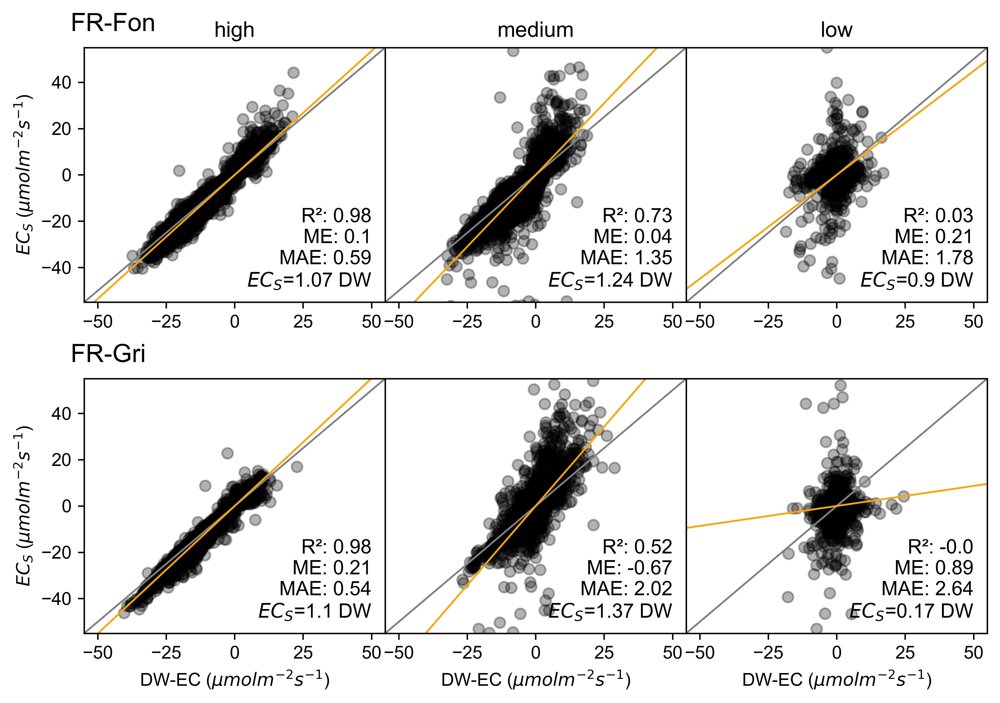

In [45]:
chunkdfs = get_dic_flux_data()

fig = plt.figure(figsize=(9, 6), dpi=600)
fig_grid = plt.GridSpec(2, 3)
plt.subplots_adjust(wspace=0, hspace=0.3)
nl = 'qc_co2_flux'
for ix, (sitename, chunkdf) in enumerate(chunkdfs.items()):
    for f in [0,1,2]:
        plt.subplot(fig_grid[ix, f])
        stat = summarisestats(chunkdf[chunkdf[nl]==f].dwt_wco2, chunkdf[chunkdf[nl]==f].co2_flux)
        stat_label = summarisestatslabel(stat, 'DW', '$EC_S$')
        plt.plot([-90, 90], [-90, 90], lw=1, c='gray')
        plt.plot([-90, 90], [-90*stat.m+stat.b, 90*stat.m+stat.b], lw=1, c='orange')
        plt.text(50, -50, stat_label, size=11, ha='right', va='bottom')
        #sq_reg(chunkdf[chunkdf[nl]==f].co2_flux, chunkdf[chunkdf[nl]==f].dwt_wco2, chunkdf[chunkdf[nl]==f].co2_flux,
        #'$EC_S$', 'DW')
        plt.scatter('dwt_wco2', 'co2_flux', data=chunkdf[chunkdf[nl]==f], c='k', alpha=0.3)
        if f>0:
            plt.yticks([])
        else:
            plt.ylabel(r"$EC_S$" + " ($μmolm^{-2}s^{-1}$)")
        plt.xlim(-55, 55)
        if ix == 1:
            plt.xlabel("DW-EC ($μmolm^{-2}s^{-1}$)")
        plt.ylim(-55, 55)
        if ix==0: plt.title({0: 'high', 1: 'medium', 2: 'low'}[f])
        if f ==0: plt.text(-60, 60, sitename, size=14, ha='left', va='bottom')


Figure S3

In [56]:
# SWITCH
opt = 'figS4'

# SCRIPT
chunkdfs = get_dic_flux_data()

fig = plt.figure(figsize=(18, 14), dpi=600)
fig_grid = plt.GridSpec(5, 12, height_ratios= [5,5,2,5,5])
plt.subplots_adjust(wspace=0, hspace=0.05)

#chunkdf["CWT_NEE_uStar_f2"] = np.nansum(chunkdf[[v for k, v in fluxData.freq_cwt.items() if ((1/k) < (60*30))]], axis=1)

for ix, (s, chunkdf_) in enumerate(chunkdfs.items()):
    months_ = pd.to_datetime(chunkdf_.TIMESTAMP).dt.month

    # Horst97
    zL =  np.array(chunkdf_['(z-d)/l'])
    u_ =  np.array(chunkdf_['u_rot'])
    z = np.array(chunkdf_['zd'])
    nm = np.where(zL>0, 2.0-1.915/(1+0.5*zL), 0.085)
    fm = nm*u_/z
    chunkdf_['fm'] = fm
    sj2n = [[(10/2**i)*y/x for i in range(17)] for x, y in list(zip(u_, z))]
    horst97 = lambda _n_, _nm_, _zL_: np.where(_zL_>0, (0.637*(_n_/_nm_))/(1+0.91*(_n_/_nm_)**2.1),
        np.where(_n_<=1, (1.05*_n_/_nm_)/(1+1.33*_n_/_nm_)**(7/4), (0.387*(_n_/_nm_))/(1+0.38*_n_/_nm_)**(7/3)))
    kaimal72 = lambda _n_: np.where(_n_<=1, (11*_n_)/(1+13.3*_n_)**(7/4), (4*_n_)/(1+3.8*_n_)**(7/3))

    kaimal72_cospectra = np.array([[kaimal72(i) for i in nl_] for nl_ in sj2n])
    kaimal72_cospectra = (kaimal72_cospectra.T * abs(np.array(chunkdf_['wco2']))).T
    horst97_cospectra = np.array([[horst97(i, nm_, zL_) for i in nl_] for nm_, nl_, zL_ in list(zip(nm, sj2n, zL))])
    #horst97_cospectra1 = (horst97_cospectra.T * abs(np.array(np.sum(chunkdf_[['wco2++wh2o', 'wco2+-wh2o']], axis=1)))).T
    horst97_cospectra = (horst97_cospectra.T * abs(np.array(chunkdf_['wco2']))).T

    chunkdft = np.array([chunkdf_.TIMESTAMP.to_list()] + [(chunkdf_[f"wco2+-wh2o_{c}"] + chunkdf_[f"wco2++wh2o_{c}"] + 
        chunkdf_[f"wco2--wh2o_{c}"] + chunkdf_[f"wco2-+wh2o_{c}"]).to_list() for c in range(18) if f"wco2+-wh2o_{c}" in chunkdf_.columns])
    
    if opt == 'figS4':
        chunkdfi = np.array([chunkdf_.TIMESTAMP.to_list()] + [(chunkdf_[f"wco2+-wh2o_{c}"] + chunkdf_[f"wco2++wh2o_{c}"]).to_list() for c in range(
            18) if f"wco2+-wh2o_{c}" in chunkdf_.columns])
        chunkdfo = np.array([chunkdf_.TIMESTAMP.to_list()] + [(chunkdf_[f"wco2--wh2o_{c}"] + chunkdf_[f"wco2-+wh2o_{c}"]).to_list() for c in range(
            18) if f"wco2--wh2o_{c}" in chunkdf_.columns])
        chunkstorun = [chunkdfi, chunkdfo]
        xlim = (0, 0.28)
    else:
        chunkdfii = np.array([chunkdf_.TIMESTAMP.to_list()] + [chunkdf_[f"wco2++wh2o_{c}"].to_list() for c in range(
            18) if f"wco2++wh2o_{c}" in chunkdf_.columns])
        chunkdfio = np.array([chunkdf_.TIMESTAMP.to_list()] + [chunkdf_[f"wco2+-wh2o_{c}"].to_list() for c in range(
            18) if f"wco2+-wh2o_{c}" in chunkdf_.columns])
        chunkdfoi = np.array([chunkdf_.TIMESTAMP.to_list()] + [chunkdf_[f"wco2-+wh2o_{c}"].to_list() for c in range(
            18) if f"wco2-+wh2o_{c}" in chunkdf_.columns])
        chunkdfoo = np.array([chunkdf_.TIMESTAMP.to_list()] + [chunkdf_[f"wco2--wh2o_{c}"].to_list() for c in range(
            18) if f"wco2--wh2o_{c}" in chunkdf_.columns])
        chunkstorun = [chunkdfii, chunkdfio, chunkdfoi, chunkdfoo]
        xlim = (0, 0.22)    

    #x0 = (pd.to_datetime("201901010000") - min(pd.to_datetime(chunkdf[0]))) / pd.Timedelta("30Min")
    #x1 = (pd.to_datetime("202301010000") - max(pd.to_datetime(chunkdf[0]))) / pd.Timedelta("30Min")
    xl = ['2019-01', '2019-07', '2020-01', '2020-07',
          '2021-01', '2021-07', '2022-01', '2022-07', '2023-01']
    xb = [(pd.to_datetime(d+"-01 0000") - min(pd.to_datetime(chunkdf_.TIMESTAMP))
           ) / pd.Timedelta("30Min") for d in xl]

    for c in range(2):
        for m in range(1, 13):
            plt.subplot(fig_grid[ix*2+ix+c, m-1])
            #plt.axhline(14.5, c='k', lw=1)
            #plt.axvline(0, c='gray', lw=1)
            cond = np.where((months_ == m) * ((chunkdf_['zL']>0)==c), True, False)
            #sumCovariance = sum(abs(np.array(chunkdf_['wco2_x'])))
            plt.plot(np.nanmean(horst97_cospectra[cond], axis=0)/sum(np.nanmean(horst97_cospectra[cond], axis=0)), 
                np.arange(0, 17, 1), 'gray', ls='--', lw=1)                
            #plt.plot(np.nanmean(kaimal72_cospectra[cond], axis=0)/sum(np.nanmean(kaimal72_cospectra[cond], axis=0)), 
            #    np.arange(0, 17, 1), 'gray', ls=':', lw=1)
            plt.plot(abs(np.nanmean(chunkdft[1:, cond].astype(float), axis=1))/sum(abs(np.nanmean(chunkdft[1:, cond].astype(float), axis=1))), 
                np.arange(0, 17, 1), 'k', ls=':', lw=1)

            if False:
                for f in chunkstorun:
                    Q25 = np.nanquantile((f[1:, cond].astype(float)), axis=1, q=.25)
                    Q75 = np.nanquantile((f[1:, cond].astype(float)), axis=1, q=.75)
                    Q25 = abs(Q25)/np.nanmax(abs(Q25))
                    Q75 = abs(Q75)/np.nanmax(abs(Q75))
                    plt.fill_betweenx(np.arange(0, 17, 1),
                                    x1=Q25, x2=Q75, alpha=0.3, lw=0)
                    if min(10**3*Q25) < xlim[0]:
                        plt.annotate(f"{round(min(10**3*Q25), 0)}", (xlim[0], list(np.arange(0, 17, 1))[list(Q25).index(min(Q25))]), (xlim[0]+5, 15),
                                    arrowprops=dict(arrowstyle="->", connectionstyle="angle,angleA=90,angleB=0,rad=10"))

            for j, f in enumerate(chunkstorun):
                Y = np.nanmean((f[1:, cond].astype(float)), axis=1)
                plt.plot(abs(Y)/np.nansum(abs(Y)),np.arange(0, 17, 1))
                Im = list(np.abs(Y)).index(max(np.abs(Y)))
                plt.text(xlim[1], list(np.arange(0, 17, 1))[
                        Im]-0.5-j*10**-1, f"←", ha="right", 
                        color=f"C{j}", fontsize="xx-large")
            
            if m == 1 and c == 0:
                plt.text(xlim[0]+.03, 19, s, size=14)
            if m == 1:
                #if c: plt.text(xlim[0]+.03, 15, r'(b) stable stratification ($z/L>0$)', size=12)
                #else: plt.text(xlim[0]+.03, 15, r'(a) neutral and unstable stratification ($z/L<=0$)', size=12)
                plt.ylabel(r"frequency $(\times10Hz)$")
                plt.yticks(np.arange(1, 18, 3), [
                    r'$2^{-'+str(e)+'}$' for e in np.arange(1, 18, 3)])
            else:
                plt.yticks([])
            
            plt.xlim(*xlim)

            if c == 0:
                plt.title(m)
                plt.xticks([])
            if ix==1 and c==1 and m == 1:
                plt.legend([pltline2d([0], [0], color=f"C{i_}", lw=1) for i_ in range(len(chunkstorun))] + 
                        [pltline2d([0], [0], color=f"k", ls=':', lw=1), pltline2d([0], [0], color=f"gray", ls='--', lw=1)],
                        [r'$φ_c^+|φ_v^+$', r'$φ_c^+|φ_v^-$', r'$φ_c^-|φ_v^+$', r'$φ_c^-|φ_v^-$'] if
                        len(chunkstorun) == 4 else [r'$φ_c^+$', r'$φ_c^-$', r'$φ_c$ (NEE)', 'Horst (97, eq. 8 and 10)'],
                        loc=(6-0.5*len(chunkstorun), -.5), ncol=len(chunkstorun),
                        title=r"Normalized distribution  ($x / \sum x$)")  # 'lower left')
        
    
        plt.subplot(fig_grid[ix*2+ix+c, 0])
        if c: plt.text(xlim[0]+.03, 15, r'(b) stable stratification ($z/L>0$)', size=12)
        else: plt.text(xlim[0]+.03, 15, r'(a) neutral and unstable stratification ($z/L<=0$)', size=12)
        plt.gca().set_zorder(1)

plt.show()

del chunkdfs, chunkdft, chunkdf_


Figure S4, S6

C:\Users\PHHERI~1\AppData\Local\Temp/ipykernel_3656/2213282927.py:16: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  chunkdf = chunkdf.groupby(["co_site", "date", "year"]).agg(np.nanmean).reset_index(drop=False)


<Figure size 5400x5400 with 0 Axes>

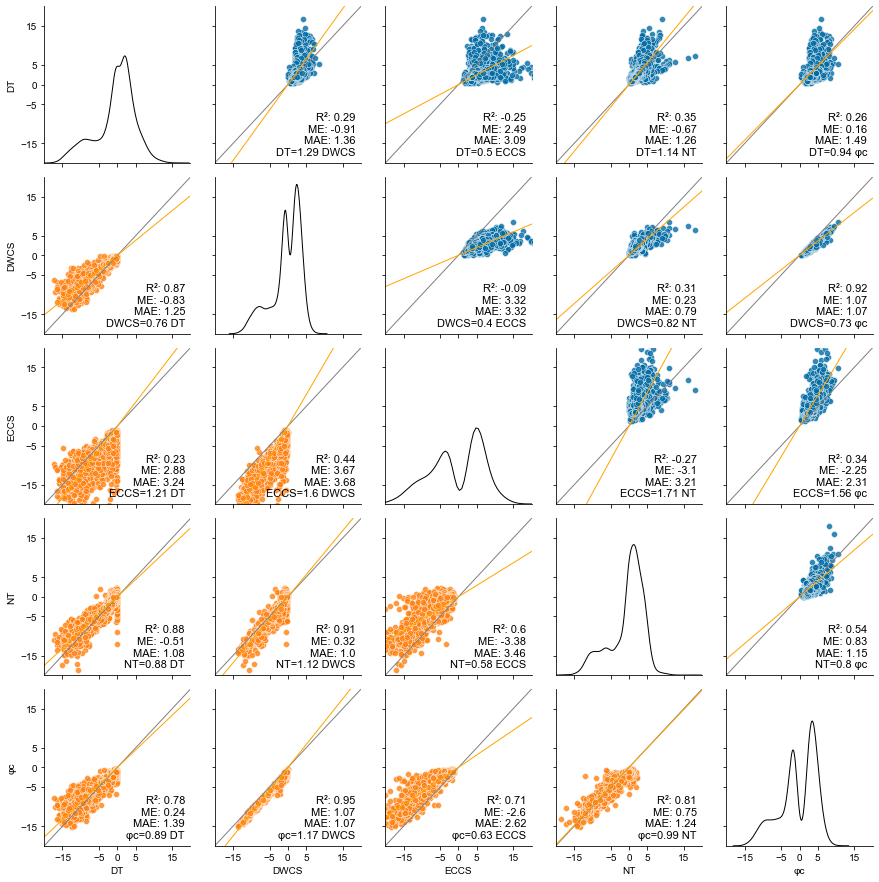

In [124]:
chunkdf = copy.deepcopy(all_flux_data)
EC_CS = pd.concat([pd.read_csv(r'data/FR-Fon/FR-Fon_EC_CS.30mn.csv').assign(co_site='FR-Fon'),
           pd.read_csv(r'data/FR-Gri/FR-Gri_EC_CS.30mn.csv').assign(co_site='FR-Gri')])
EC_CS['TIMESTAMP'] = pd.to_datetime(EC_CS.TIMESTAMP)
EC_CS['EC_Reco_ECCS_uStar'] = np.nansum(EC_CS[EC_CS.columnsmatch('wco2\+..?h2o$')], axis=1)
EC_CS['EC_GPP_ECCS_uStar'] = np.nansum(EC_CS[EC_CS.columnsmatch('wco2\-..?h2o$')], axis=1)
EC_CS = EC_CS[['co_site', 'TIMESTAMP', 'EC_Reco_ECCS_uStar', 'EC_GPP_ECCS_uStar']]
chunkdf = chunkdf.merge(EC_CS, on=['co_site', 'TIMESTAMP'], how='left')
chunkdf["EC_Reco_ECCS_uStar"] = chunkdf.EC_Reco_ECCS_uStar / chunkdf.Vd
chunkdf["EC_GPP_ECCS_uStar"] = chunkdf.EC_GPP_ECCS_uStar / chunkdf.Vd

#chunkdf['in_sunrise_sunset'] = [(d.time() > sun(city.observer, date=d)['dawn'].time()) * (d.time() < sun(city.observer, date=d)['dusk'].time()) for d in chunkdf.TIMESTAMP]
chunkdf["year"] = chunkdf.TIMESTAMP.dt.year
chunkdf["year"] = chunkdf["year"].astype(str)
chunkdf['date'] = chunkdf.TIMESTAMP.dt.date
chunkdf = chunkdf.groupby(["co_site", "date", "year"]).agg(np.nanmean).reset_index(drop=False)

chunkdf["DW_Reco_φc_uStar"] = chunkdf["dwt_wco2++wh2o_uStar_f"] + chunkdf["dwt_wco2+-wh2o_uStar_f"]
chunkdf["DW_GPP_φc_uStar"] = chunkdf["dwt_wco2-+wh2o_uStar_f"] + chunkdf["dwt_wco2--wh2o_uStar_f"]

for c in [f"{i}_GPP_{m}_uStar" for m in ["MRF", "GLF", "TKF"] for i in ["EP", "DW"]]:
    chunkdf[c] = -1 * chunkdf[c]

# aka
for v0, v1 in {"MRF": "NT", "TKF": "DT"}.items():
    for c in [f"{i}_{v}_"+"{}_uStar" for i in ["EP", "DW"] for v in ["GPP", "Reco"]]:
        chunkdf[c.format(v1)] = chunkdf[c.format(v0)]
# aka
#for c in ["EC_Reco_DW_uStar", "EC_GPP_DW_uStar"]:
#    for v0, v1 in {"DW": "ECDW"}.items():
#        chunkdf[c.replace(v0, v1)] = chunkdf[c]

#chunkdf.rename(columns={c: c.replace('') for c in chunkdf.columnsmatch('.{3}_.+_.MRF_uStar')}, inplace=True)
chunkdf.rename(columns={'DW_Reco': 'DW_Reco_DWCS', 'DW_GPP': 'DW_GPP_DWCS'}, inplace=True)
chunkdf.rename(columns={'EC_Reco_ECDW_uStar': 'EC_Reco_ECCS_uStar', 'EC_GPP_ECDW_uStar': 'EC_GPP_ECCS_uStar'}, inplace=True)

opt = 'figS6'
# partitioning methods
if opt=='figS6':
    cols = ["EP_Reco_NT_uStar", "EP_GPP_NT_uStar",
    "EP_Reco_DT_uStar", "EP_GPP_DT_uStar",
    #"EP_Reco_GLF_uStar", "EP_GPP_GLF_uStar",
    "EC_Reco_ECCS_uStar", "EC_GPP_ECCS_uStar",
    "DW_Reco_φc_uStar", "DW_GPP_φc_uStar",
    "DW_Reco_DWCS", "DW_GPP_DWCS"]
elif opt=='figSy':
    cols = ["EP_Reco_NT_uStar", "EP_GPP_NT_uStar",
    "EP_Reco_DT_uStar", "EP_GPP_DT_uStar",
    "DW_Reco_DWCS", "DW_GPP_DWCS"]
elif opt=='figS4':
    chunkdf.rename(columns={
        "EP_NEE_MRF_uStar": "EP_NEE_ECNT_uStar", "DW_NEE_MRF_uStar": "DW_NEE_DWNT_uStar",
        #"EP_NEE_DT_uStar": "EP_NEE_ECDT_uStar", "DW_NEE_DT_uStar": "DW_NEE_DWDT_uStar",
        "EP_Reco_MRF_uStar": "EP_Reco_ECNT_uStar", "EP_GPP_MRF_uStar": "EP_GPP_ECNT_uStar",
        "EP_Reco_TKF_uStar": "EP_Reco_ECDT_uStar", "EP_GPP_TKF_uStar": "EP_GPP_ECDT_uStar",
        "DW_Reco_MRF_uStar": "DW_Reco_DWNT_uStar", "DW_GPP_MRF_uStar": "DW_GPP_DWNT_uStar",
        "DW_Reco_TKF_uStar": "DW_Reco_DWDT_uStar", "DW_GPP_TKF_uStar": "DW_GPP_DWDT_uStar"}, inplace=True)
    cols = ["EP_Reco_ECNT_uStar", "EP_GPP_ECNT_uStar", 
        "EP_Reco_ECDT_uStar", "EP_GPP_ECDT_uStar", 
        "DW_Reco_DWNT_uStar", "DW_GPP_DWNT_uStar", 
        "DW_Reco_DWDT_uStar", "DW_GPP_DWDT_uStar"]

chunkdf = chunkdf.melt(id_vars=["year", "date", "co_site"], value_vars=cols)
chunkdf['PT'] = chunkdf.variable.map(lambda x: x.split("_")[2])
chunkdf['VA'] = chunkdf.variable.map(lambda x: x.split("_")[1])
vs = chunkdf['PT'].unique()
chunkdf = chunkdf.pivot(index=["year", "date", "co_site", "VA"], columns='PT', values='value').reset_index(drop=False)

for v in vs:#["NT", "DT", "DW"]:
    chunkdf[v] = np.where((abs(chunkdf[v])<10**3), chunkdf[v], np.nan)

def sq_VAR(x, y, va, **kw):
    try: 
        xn = x.name
    except:
        xn = "x" 
    try: 
        yn = y.name
    except:
        yn = "y" 
    sqdf = chunkdf[chunkdf.co_site == kw.get('label', "")] if 'label' in kw.keys() else chunkdf
    #ref = np.where((sqdf.VA==va) * (abs(x)<10**3), sqdf["MRF"], np.nan)
    x = np.where((sqdf.VA==va) * (abs(x)<10**3), x, np.nan)
    y = np.where((sqdf.VA==va) * (abs(y)<10**3), y, np.nan)
    sns.scatterplot(x=x, y=y, **kw)
    
    stat = summarisestats(x, y)
    plt.plot([-20, 20], [-20, 20], lw=1, c='gray')
    plt.plot([-20, 20], [-20*stat.m+stat.b, 20*stat.m+stat.b], lw=1, c='orange')
    stat_label = summarisestatslabel(stat, xn, yn)
    plt.text(18.5, -18.5, stat_label, size=11, horizontalalignment='right', verticalalignment='bottom')

def sq_Reco(*a, **kw):
    kw.update({'color': 'C0'})
    sq_VAR(*a, va='Reco', **kw)

def sq_GPP(*a, **kw):
    kw.update({'color': 'C1'})
    sq_VAR(*a, va='GPP', **kw)


fig = plt.figure(figsize=(9, 9), dpi=600)
g = sns.PairGrid(chunkdf)#, hue="co_site")
g.map_upper(sq_Reco, alpha=0.8)
g.map_lower(sq_GPP, alpha=0.8)
g.map_diag(sns.kdeplot, color='k', lw=1, legend=False)
g.set(ylim=(-20, 20), yticks=[-15, -5, 0, 5, 15], xlim=(-20, 20), xticks=[-15, -5, 0, 5, 15])
g.map_diag(lambda *a, **k: plt.yticks([]))

del chunkdf, cols


Figure S5

In [54]:
fig = plt.figure(figsize=(18, 16), dpi=600)
fig_grid = plt.GridSpec(11, 1, height_ratios=[1]+[3]*2+[2]+[3]*7)
plt.subplots_adjust(wspace=0, hspace=0)

ix = 0

for t, v in {'(a)': ['E_0_uStar','R_ref_uStar'], '(b)': ['FP_RRef_Night','FP_GPP2000','FP_k','FP_beta','FP_alpha','FP_RRef','FP_E0']}.items():
    plt.subplot(fig_grid[ix, 0])
    plt.text(0.005, 0.3, t, size=12)
    plt.axis('off')
    ix += 1
    for c in v:   
        plt.subplot(fig_grid[ix, 0])
        for cs, s in {'C0': 'FR-Fon', 'C1': 'FR-Gri'}.items():
            for m in ["MRF", "TKF"]:#, "GLF"
                for ls, k in {'--': "EP" ,'-': "DW"}.items():
                    addon_prt = pd.read_csv(os.path.join(os.getcwd(), f'data/{s}',
                                            f"{s}_full_gapfill_{m}_{k}.30mn.csv"), na_values=["NA"])
                    addon_prt["TIMESTAMP"] = pd.to_datetime(addon_prt.TIMESTAMP)
                    if c in addon_prt.columns:
                        plt.plot("TIMESTAMP", c, data=addon_prt.dropna(subset=c), #, label=f'{s} {m} {k} {c}', 
                        c=cs, ls=ls, lw=1)
                        plt.ylabel(c)
                        #ma_x = moving_average(addon_prt[c], 48*30)
                        #st_x = np.nanstd(addon_prt[c])
                        #plt.plot(addon_prt.TIMESTAMP[:len(ma_x)], ma_x, c=cs, ls=ls, lw=1)
                        #plt.fill_between(addon_prt.TIMESTAMP[:len(ma_x)], ma_x-1.5*st_x, ma_x+1.5*st_x, alpha=0.6, color=cs)
                        
                        plt.xlim(pd.to_datetime('20190101'), pd.to_datetime('20230101'))
                        if ix not in [2,10]:
                            plt.xticks([])
                        else:
                            xl = ['2019-01', '2019-07', '2020-01', '2020-07', '2021-01', '2021-07', '2022-01', '2022-07', '2023-01']
                            plt.xticks([pd.to_datetime(d+"-01 0000") for d in xl])
                            xx = [pd.to_datetime(f'{yy}{str(mm).zfill(2)}01') for mm in range(1, 13) for yy in range(2019, 2023)]
                            plt.gca().xaxis.set_minor_locator(matplotlib.ticker.FixedLocator(matplotlib.dates.date2num(xx)))

        ix += 1
plt.legend([pltline2d([0], [0], color=f"C{i}", lw=2) for i in range(2)]+[pltline2d([0], [0], color="gray", ls=l, lw=2) for l in ['-', '--']], 
    ['FR-Fon','FR-Gri','DW',r'$EC_S$'], loc=(0.37, -0.5), ncols=4)



Figure S7

C:\Users\PHHERI~1\AppData\Local\Temp/ipykernel_11116/1354803012.py:12: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  chunkdf = chunkdf.groupby("date").agg(np.nanmean).reset_index()
C:\Users\PHHERI~1\AppData\Local\Temp/ipykernel_11116/1354803012.py:12: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  chunkdf = chunkdf.groupby("date").agg(np.nanmean).reset_index()


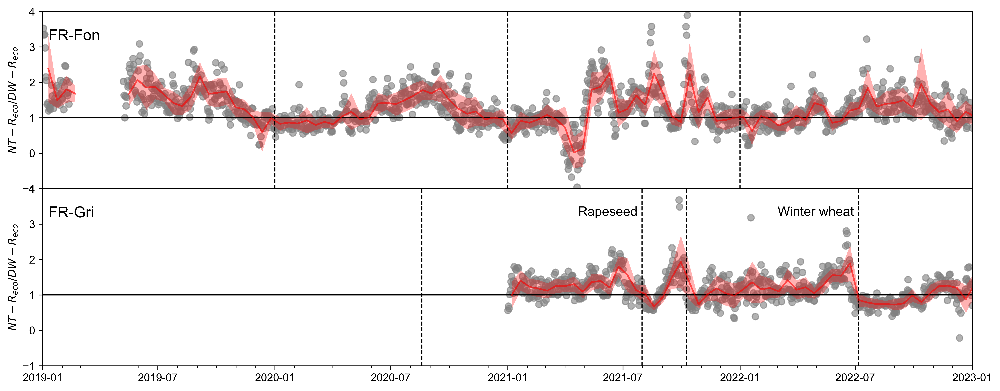

In [79]:
chunkdfs = get_dic_flux_data()

fig = plt.figure(figsize=(18, 9), dpi=600)
fig_grid = plt.GridSpec(3, 20)
plt.subplots_adjust(wspace=0, hspace=0)

for ix, (s, chunkdf) in enumerate(chunkdfs.items()):
    chunkdf["NT_DW_Reco_ratio"] = chunkdf["DW_Reco_MRF_uStar"] / chunkdf["DW_Reco"]
    chunkdf["NT_DW_Reco_ratio"] = np.where(abs(chunkdf.NT_DW_Reco_ratio)>10, np.nan, chunkdf.NT_DW_Reco_ratio)
    
    chunkdf["date"] = chunkdf.TIMESTAMP.dt.ceil('1D')
    chunkdf = chunkdf.groupby("date").agg(np.nanmean).reset_index()
    
    plt.subplot(fig_grid[ix, :17])
    plt.axhline(1, c='k', ls='-', lw=1)
    if s=="FR-Gri":
        sea0 = [pd.to_datetime("20200819"), pd.to_datetime("20210731"), pd.to_datetime("20211009"),  pd.to_datetime("20220706")]
        [plt.text(pd.to_datetime(c['harvest']) - pd.Timedelta('7 days'), 3.5, c['name'], size=12, va='top', ha='right') for c in FRGriCalendar.values()]
    else:
        sea0 = [pd.to_datetime(f"{y}01010000") for y in range(2019, 2023)]
    for s_ in sea0:
        plt.axvline(s_, c="k", ls="--", lw=1)
    sea0 = sea0 + [pd.to_datetime('20230101')]

    plt.scatter("date", "NT_DW_Reco_ratio", data=chunkdf, c='gray', alpha=0.6)
    
    chunkdf["date"] = chunkdf.date.dt.ceil('14D')
    chunkdf = chunkdf.groupby("date").agg([np.nanmean, np.nanstd]).reset_index()
    plt.plot(chunkdf.date, chunkdf["NT_DW_Reco_ratio"]['nanmean'], c='red', alpha=0.6)
    plt.fill_between(chunkdf.date, 
        chunkdf["NT_DW_Reco_ratio"]['nanmean']-chunkdf["NT_DW_Reco_ratio"]['nanstd'],
        chunkdf["NT_DW_Reco_ratio"]['nanmean']+chunkdf["NT_DW_Reco_ratio"]['nanstd'], 
        color='red', lw=0, alpha=0.3)
    
    plt.text(pd.to_datetime('20190110'), 3.5, s, size=14, va='top', ha='left')
    plt.xlim(pd.to_datetime('20190101'), pd.to_datetime('20230101'))
    plt.ylim(-1, 4)
    plt.ylabel(r"$NT-R_{eco}/DW-R_{eco}$")

    if ix == 0:
        plt.xticks([])
    else:
        plt.gca().xaxis.set_minor_locator(matplotlib.ticker.FixedLocator(matplotlib.dates.date2num(firstOfEveryMonth)))

del chunkdfs, chunkdf


Figure S8

In [82]:
chunkdfs = get_dic_flux_data()

fig = plt.figure(figsize=(18, 18), dpi=600)
fig_grid = plt.GridSpec(8, 12, height_ratios=(2,3,3,3,2,3,3,3))
plt.subplots_adjust(wspace=0, hspace=0)

for ix, (s, chunkdf) in enumerate(chunkdfs.items()):
    v = "HOD"
    chunkdf['HOD'] = chunkdf.TIMESTAMP.dt.hour
    chunkdf['month'] = chunkdf.TIMESTAMP.dt.month
    chunkdf['time'] = chunkdf.TIMESTAMP.dt.hour + chunkdf.TIMESTAMP.dt.minute/60
    #chunkdf['index'] = ["GPP" if v in ['dwt_wco2+-h2o', "dwt_wco2++h2o"] else "Reco" if v in ['dwt_wco2--h2o', "dwt_wco2-+h2o"] else "" for v in chunkdf.variable]
    
    plt.subplot(fig_grid[ix*3+ix, :])
    plt.text(.02, 0.3, s, size=14, va='bottom', ha='left')
    plt.axis('off')
    for m in range(1,13):
        chunkMM = chunkdf[(chunkdf.month == m)].reset_index(drop=True)
        for c in chunkMM.columnsmatch('.+_GPP_.{3}_uStar'):
            chunkMM[c] = -chunkMM[c]

        options = {'NT': ['EP_Reco_MRF_uStar', "EP_GPP_MRF_uStar"],
            'DT': ['EP_Reco_TKF_uStar', "EP_GPP_TKF_uStar"],
            'DW': ["DW_Reco", "DW_GPP"]}

        for j, (key, refs) in enumerate(options.items()):
            plt.subplot(fig_grid[ix*3+j+ix+1, m-1])
            X = chunkMM.time.unique()
            
            plt.axhline(0, lw=1, color='k', zorder=-99)
            
            Ys = []
            for i, ref in enumerate(refs):
                Yref = np.array([np.nanmedian(chunkMM[(chunkMM.time == x)][ref]) for x in X])
                Qr25 = np.array([np.nanquantile(chunkMM[(chunkMM.time == x)][ref], q=0.25) for x in X])
                Qr75 = np.array([np.nanquantile(chunkMM[(chunkMM.time == x)][ref], q=0.75) for x in X])
                Qr05 = np.array([np.nanquantile(chunkMM[(chunkMM.time == x)][ref], q=0.05) for x in X])
                Qr95 = np.array([np.nanquantile(chunkMM[(chunkMM.time == x)][ref], q=0.95) for x in X])
                #plt.fill_between(X, Qr05, Qr95, color=f'C{i}', alpha=0.1, zorder=-9)
                plt.plot(X, Qr05, c=f'C{i}', lw=1, ls=':', zorder=-8)
                plt.plot(X, Qr95, c=f'C{i}', lw=1, ls=':', zorder=-8)
                plt.fill_between(X, Qr05, Qr95, color=f'C{i}', alpha=0.1, zorder=-9)
                plt.fill_between(X, Qr25, Qr75, color=f'C{i}', alpha=0.3, zorder=-9)
                plt.plot(X, Yref, c=f'C{i}', lw=1, zorder=-8)
                Ys += [Yref]
            
            if ix==0 and j==0: plt.title(m)

            plt.ylim(-38, 18)
            plt.xlim(0,23)
            plt.xticks([3, 9, 15, 21])
            #if ix==0:
            #    plt.xticks([])
            #plt.xlabel("")
            if m==1:
                plt.text(.3, 14, key, size=12, va='top', ha='left')
                if j==1: plt.ylabel(r"GPP, $R_{eco}$ ($gCm^{-2}s^{-1}$)")
            else:
                plt.yticks([])
        
        if m == 6:
            if ix == (len(chunkdfs)-1):
                #plt.legend(title="")
                plt.legend([pltline2d([0], [0], marker='s', color=f"C{c}", lw=2) for c in range(2)], 
                [r'$R_{eco}$', 'GPP'], loc=(0,-0.4), ncols=2)

        del chunkMM

del chunkdf, v


Figure S9

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


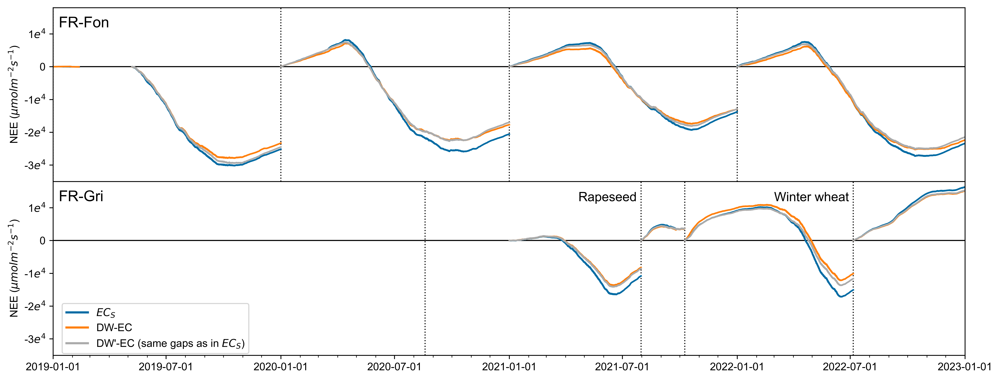

In [81]:
chunkdfs = get_dic_flux_data()

for k in chunkdfs.keys():
    testdf = pd.read_csv(f'data/{k}/{k}_full_gapfill_MRF_DWgapswithSTAandITC.30mn.csv', na_values=["NA"])
    testdf["TIMESTAMP"] = pd.to_datetime(testdf.TIMESTAMP).dt.tz_localize(None)
    testdf["DWT_NEE_uStar_*"] = testdf.NEE_uStar_f
    chunkdfs[k] = chunkdfs[k].merge(testdf[['TIMESTAMP', 'DWT_NEE_uStar_*']], on='TIMESTAMP', how='left')

fig = plt.figure(figsize=(18, 9), dpi=600)
fig_grid = plt.GridSpec(3, 20)
plt.subplots_adjust(wspace=0, hspace=0)

#chunkdf["CWT_NEE_uStar_f2"] = np.nansum(chunkdf[[v for k, v in fluxData.freq_cwt.items() if ((1/k) < (60*30))]], axis=1)

#compare = ("co2_flux", "dwt_co2w")  # , "cwt_co2w")
compare = ("EP_NEE_uStar_f", "DWT_NEE_uStar_f",
           "DWT_NEE_uStar_*")  # , "CWT_NEE_uStar_f")
labels = ["EC_S-NEE", "DW-NEE", "CW-NEE"]
cunit = [(1/10**6) * (30*60)] * 3
ccolors = [f"C{i}" for i in range(len(compare))]

for ix, (s, chunkdf) in enumerate(chunkdfs.items()):
    chunkdf["DW_NEE"] = chunkdf[chunkdf.columnsmatch(
        'dwt_wco2..wh2o_uStar_f')].sum(axis=1)

    plt.subplot(fig_grid[ix, :17])
    plt.axhline(0, c='k', lw=1)
    #chunkdf[compare[1]] = np.where(np.abs(chunkdf[compare[1]])>60, 0, chunkdf[compare[1]])
    if s=="FR-Gri":
        datesOfHarvestSowing = np.sort([c['harvest'] for c in FRGriCalendar.values()]+[c['sowing'] for c in FRGriCalendar.values()])
        sea0 = [pd.to_datetime(d) for d in datesOfHarvestSowing]#[pd.to_datetime("20200819"), pd.to_datetime("20210731"), pd.to_datetime("20211009"),  pd.to_datetime("20220706")]
        #sea1 = [pd.to_datetime("20210301"), pd.to_datetime("20210731"), pd.to_datetime("20220301"),  pd.to_datetime("20220706")]
        [plt.text(pd.to_datetime(c['harvest']) - pd.Timedelta('7 days'), 12e3, c['name'], size=12, ha='right') for c in FRGriCalendar.values()]
        chunkdf['season'] = -1
        for i, s_ in enumerate(datesOfHarvestSowing[:-1]):
            chunkdf['season'] = np.where((chunkdf.TIMESTAMP>pd.to_datetime(s_))*(chunkdf.TIMESTAMP<=pd.to_datetime(datesOfHarvestSowing[i+1])), i, chunkdf.season)
    else:
        sea0 = [pd.to_datetime(f"{y}01010000") for y in range(2019, 2023)]
        chunkdf['season'] = chunkdf.TIMESTAMP.dt.year

    for s_ in sea0:
        plt.axvline(s_, c="k", ls=":", lw=1)
    
    for s_ in chunkdf['season'].unique():
        for i, c in enumerate(compare):
            plt.plot(chunkdf[chunkdf.season==s_].TIMESTAMP, chunkdf[chunkdf.season==s_][compare[i]].cumsum(), c=ccolors[i])
    
        #plt.plot(chunkdf[chunkdf.season==s_].TIMESTAMP, 1.09*chunkdf[chunkdf.season==s_][compare[i]].cumsum(), lw=1, ls='--', c=ccolors[i])
    
    #plt.xlim(tt.minmax(chunkdf.TIMESTAMP))
    plt.text(pd.to_datetime('20190110'), 12e3, s, size=14)
    plt.xlim(pd.to_datetime('20190101'), pd.to_datetime('20230101'))
    plt.ylim(-35e3, 18e3)
    plt.yticks(np.arange(-3e4, 2e4, 1e4), [str(i)+r'$e^4$' if i!=0 else '0' for i in np.arange(-3, 2, 1)])
    plt.ylabel('NEE 'r"($μmolm^{-2}s^{-1}$)")
    if ix < (len(chunkdfs)-1):
        plt.xticks([])
    else:
        xl = ['2019-01', '2019-07', '2020-01', '2020-07', '2021-01', '2021-07', '2022-01', '2022-07', '2023-01']
        plt.xticks([pd.to_datetime(d+"-01 0000") for d in xl])
        xx = [pd.to_datetime(f'{yy}{str(mm).zfill(2)}01') for mm in range(1, 13) for yy in range(2019, 2023)]
        plt.gca().xaxis.set_minor_locator(matplotlib.ticker.FixedLocator(matplotlib.dates.date2num(xx)))
        plt.legend(loc='lower left')
    
    if ix == 1:
        plt.legend([pltline2d([0], [0], color=f"C{i}", lw=2) for i in range(3)], # + [pltline2d([0], [0], color=f"C1", ls='--', lw=2)], 
            [r'$EC_S$','DW-EC',r"DW'-EC (same gaps as in $EC_S$)"], loc=(0.01, 0.01), ncols=1)

plt.show()

del chunkdfs, chunkdf
